In [171]:
import os
import re
from collections import Counter

import anndata
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import enrichrpy.enrichr as een
import enrichrpy.plotting as epl

In [172]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.dpi'] = 300

In [173]:
fig_dir = '../results/figures'
sc.settings.figdir = fig_dir

In [195]:
a = sc.read_h5ad('../data/single_cell/annotated/all_annotated.h5ad')
a

AnnData object with n_obs × n_vars = 196868 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets score', 'be

## single cell

In [75]:
set(a.obs['cell_type'])

{'Acinar',
 'B cell',
 'Endothelial',
 'Erythrocyte',
 'Fibroblast',
 'Malignant',
 'Mast',
 'Monocyte/DC',
 'NK/T cell',
 'Plasma',
 'Platelets',
 'Stellate'}

In [76]:
set(a.obs['cell_type_specific'])

{'Acinar',
 'B cell',
 'CD4 T cell',
 'CD8 T cell ',
 'CD8 T cell - Exhausted',
 'DC',
 'Endothelial',
 'Erythrocyte',
 'Malignant - Basal',
 'Malignant - Classical',
 'Mast',
 'NK',
 'Normal Epithelial',
 'Plasma',
 'Platelets',
 'Stellate',
 'T cell - Proliferating',
 'TAM - C1QC',
 'TAM - FCN1',
 'TAM - SPP1',
 'TAM - proliferating',
 'Treg',
 'iCAF',
 'myCAF',
 'pDC'}

In [215]:
list(zip(a.obs['cell_type'].cat.categories, a.uns['cell_type_colors']))

[('Acinar', '#1f77b4'),
 ('B cell', '#ff7f0e'),
 ('Endothelial', '#279e68'),
 ('Erythrocyte', '#d62728'),
 ('Fibroblast', '#aa40fc'),
 ('Malignant', '#8c564b'),
 ('Mast', '#e377c2'),
 ('Monocyte/DC', '#b5bd61'),
 ('NK/T cell', '#17becf'),
 ('Plasma', '#aec7e8'),
 ('Platelets', '#ffbb78'),
 ('Stellate', '#98df8a')]

In [219]:
type_to_color = {
    '#ff7f0e': '#98df8a',
    '#98df8a': '#ff7f0e',
}

a.uns['cell_type_colors'] = [type_to_color.get(x, x) for x in a.uns['cell_type_colors']]

macro cell types

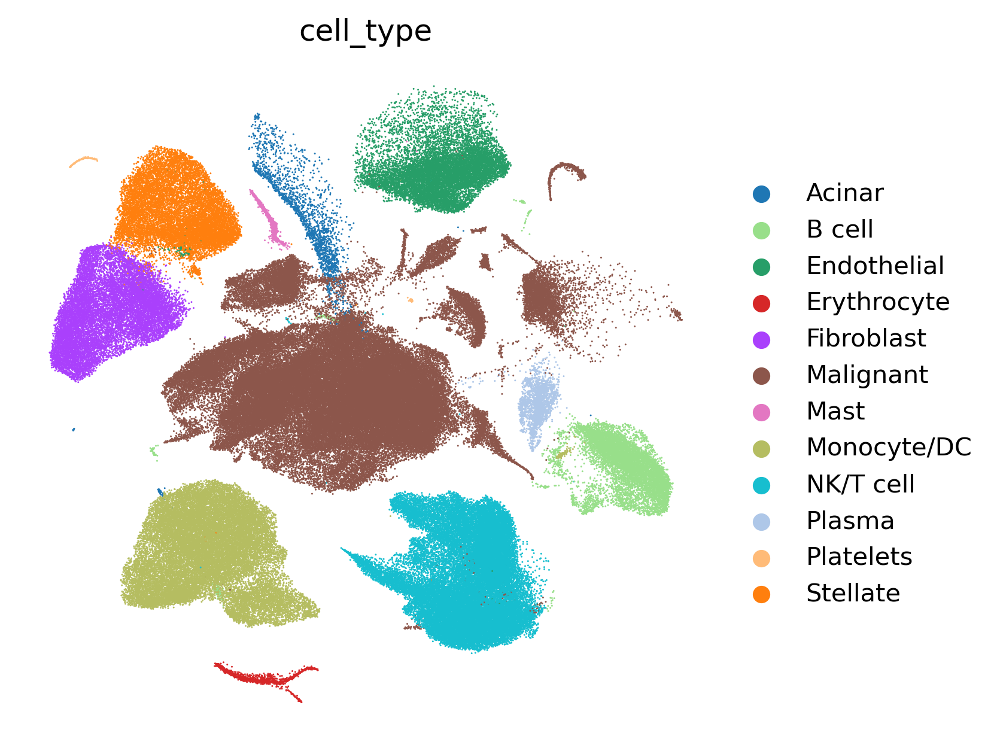

In [227]:
fig, ax = plt.subplots(figsize=(5,5))
# sc.pl.umap(a, color='cell_type', ax=ax, size=2, save='macro_cell_type.png', sort_order=False)
sc.pl.umap(a, color='cell_type', ax=ax, size=2, save='macro_cell_type.png', sort_order=False, frameon=False)

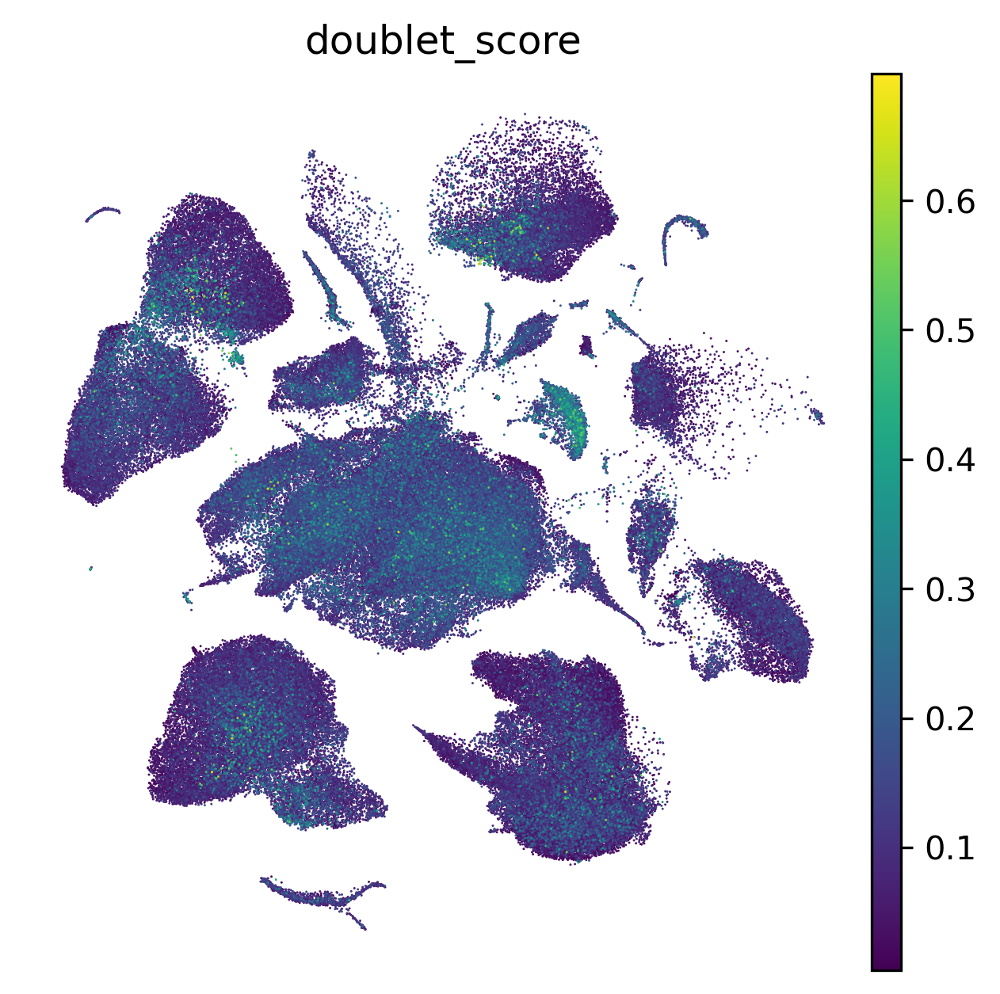

In [228]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(a, color='doublet_score', ax=ax, size=2, save='doublet_score.png', frameon=False)

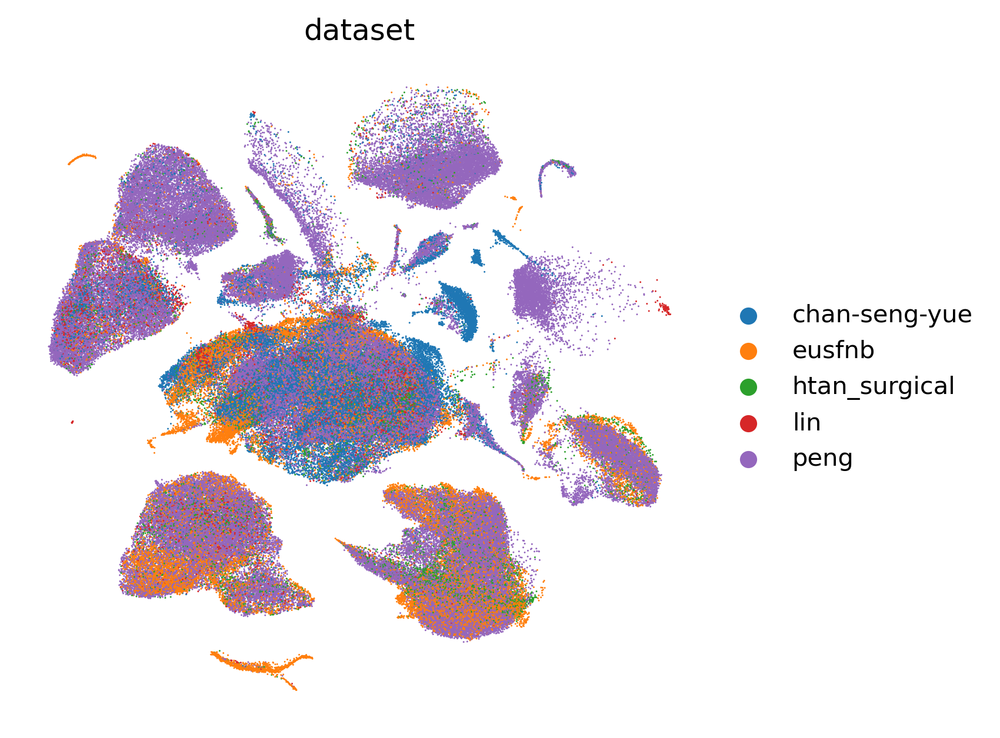

In [229]:
fig, ax = plt.subplots(figsize=(5,5))
order = a.obs.index.to_list()
np.random.shuffle(order)
sc.pl.umap(a[order],
           color='dataset', ax=ax, size=2, save='macro_dataset.png', sort_order=False, frameon=False)

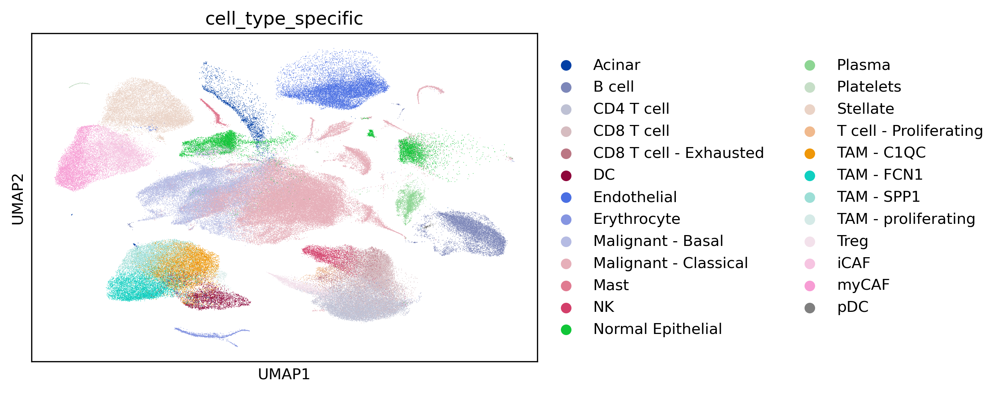

In [238]:
a.uns.pop('cell_type_specific_colors')
sc.pl.umap(a, color='cell_type_specific')

In [239]:
list(zip(a.obs['cell_type_specific'].cat.categories, a.uns['cell_type_specific_colors']))

[('Acinar', '#023fa5'),
 ('B cell', '#7d87b9'),
 ('CD4 T cell', '#bec1d4'),
 ('CD8 T cell ', '#d6bcc0'),
 ('CD8 T cell - Exhausted', '#bb7784'),
 ('DC', '#8e063b'),
 ('Endothelial', '#4a6fe3'),
 ('Erythrocyte', '#8595e1'),
 ('Malignant - Basal', '#b5bbe3'),
 ('Malignant - Classical', '#e6afb9'),
 ('Mast', '#e07b91'),
 ('NK', '#d33f6a'),
 ('Normal Epithelial', '#11c638'),
 ('Plasma', '#8dd593'),
 ('Platelets', '#c6dec7'),
 ('Stellate', '#ead3c6'),
 ('T cell - Proliferating', '#f0b98d'),
 ('TAM - C1QC', '#ef9708'),
 ('TAM - FCN1', '#0fcfc0'),
 ('TAM - SPP1', '#9cded6'),
 ('TAM - proliferating', '#d5eae7'),
 ('Treg', '#f3e1eb'),
 ('iCAF', '#f6c4e1'),
 ('myCAF', '#f79cd4'),
 ('pDC', '#7f7f7f')]

In [240]:
type_to_color = {
    '#b5bbe3': '#416b3f',
    '#e6afb9': '#81d76f',
    '#f79cd4': '#997163',
    '#f6c4e1': '#fdbf7f',
    '#0fcfc0': '#2c5493',
    '#ef9708': '#7cc4d5',
    '#9cded6': '#7f64a2'
}

a.uns['cell_type_specific_colors'] = [type_to_color.get(x, x) for x in a.uns['cell_type_specific_colors']]

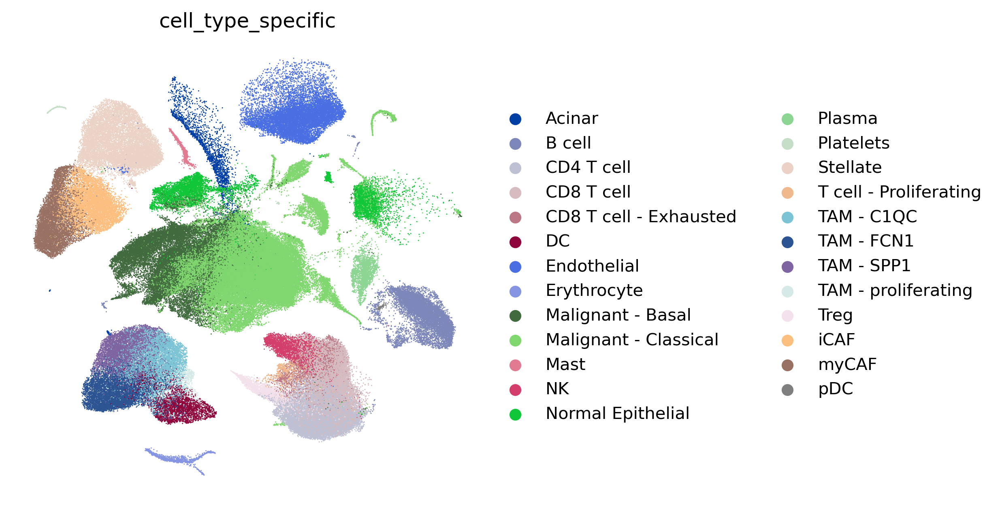

In [241]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(a, color='cell_type_specific', ax=ax, size=2, save='macro_cell_type_specific.png', frameon=False)

#### malignant

In [242]:
malignant = sc.read_h5ad('../data/single_cell/annotated/malignant_annotations.h5ad')
epi = sc.read_h5ad('../data/single_cell/annotated/malignant_and_normal_annotations.h5ad')

In [243]:
epi = epi[epi.obs['tissue_type']=='tumor_primary']
epi.obs['epithelial_type'] = [ct if cid not in malignant.obs.index else malignant.obs.loc[cid, 'specific_cell_type']
                              for cid, ct in zip(epi.obs.index.to_list(), epi.obs['specific_cell_type'])]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/ipykernel_launcher.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  This is separate from the ipykernel package so we can avoid doing imports until


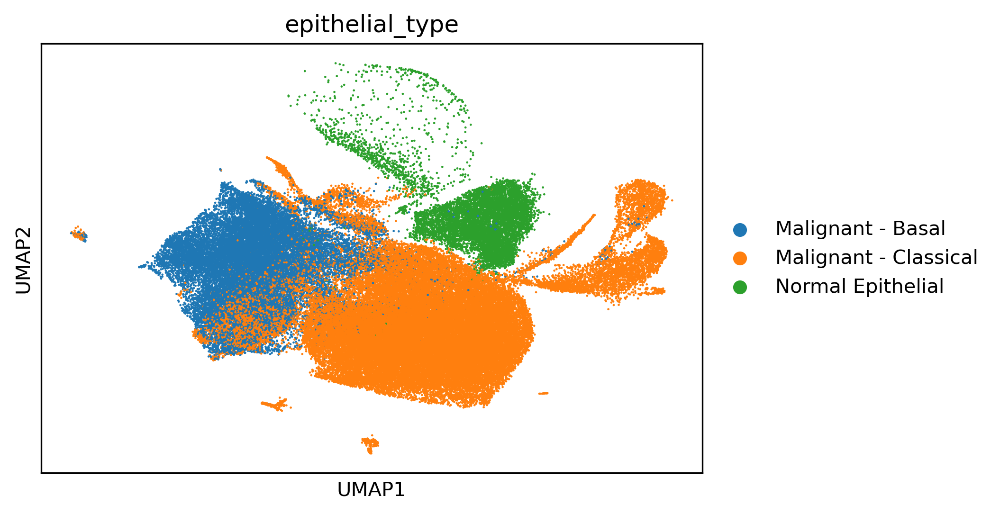

In [246]:
sc.pl.umap(epi, color='epithelial_type', size=5)

In [247]:
list(zip(epi.obs['epithelial_type'].cat.categories, epi.uns['epithelial_type_colors']))

[('Malignant - Basal', '#1f77b4'),
 ('Malignant - Classical', '#ff7f0e'),
 ('Normal Epithelial', '#2ca02c')]

In [250]:
list(zip(a.obs['cell_type_specific'].cat.categories, a.uns['cell_type_specific_colors']))

[('Acinar', '#023fa5'),
 ('B cell', '#7d87b9'),
 ('CD4 T cell', '#bec1d4'),
 ('CD8 T cell ', '#d6bcc0'),
 ('CD8 T cell - Exhausted', '#bb7784'),
 ('DC', '#8e063b'),
 ('Endothelial', '#4a6fe3'),
 ('Erythrocyte', '#8595e1'),
 ('Malignant - Basal', '#416b3f'),
 ('Malignant - Classical', '#81d76f'),
 ('Mast', '#e07b91'),
 ('NK', '#d33f6a'),
 ('Normal Epithelial', '#11c638'),
 ('Plasma', '#8dd593'),
 ('Platelets', '#c6dec7'),
 ('Stellate', '#ead3c6'),
 ('T cell - Proliferating', '#f0b98d'),
 ('TAM - C1QC', '#7cc4d5'),
 ('TAM - FCN1', '#2c5493'),
 ('TAM - SPP1', '#7f64a2'),
 ('TAM - proliferating', '#d5eae7'),
 ('Treg', '#f3e1eb'),
 ('iCAF', '#fdbf7f'),
 ('myCAF', '#997163'),
 ('pDC', '#7f7f7f')]

In [251]:
type_to_color = {
    '#1f77b4': '#416b3f',
    '#ff7f0e': '#81d76f',
    '#2ca02c': '#1f77b4',
}

epi.uns['epithelial_type_colors'] = [type_to_color.get(x, x) for x in epi.uns['epithelial_type_colors']]

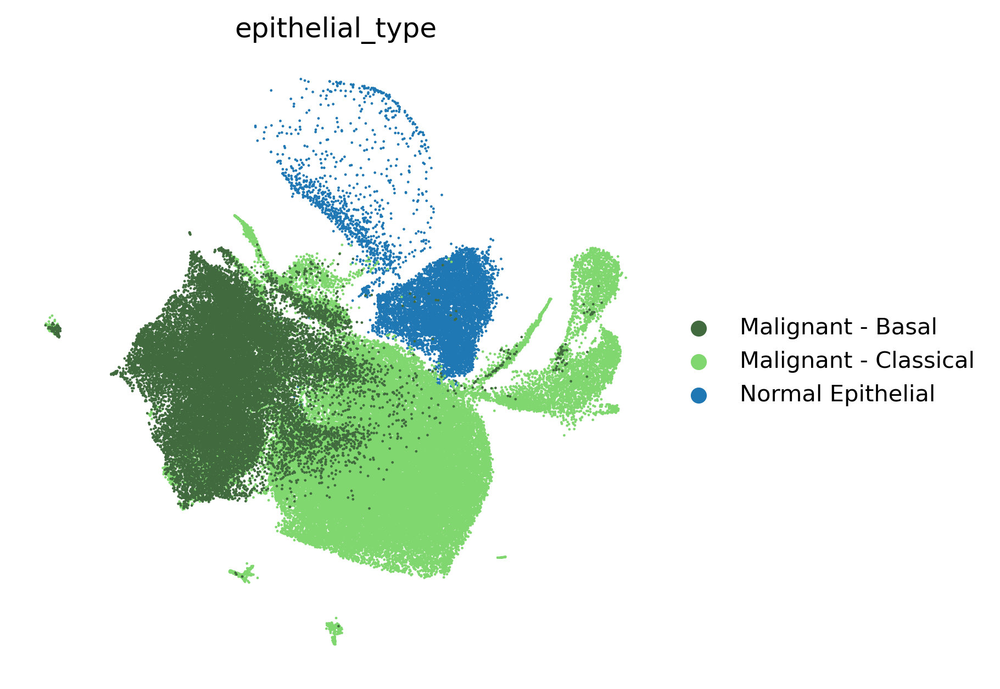

In [253]:
fig, ax = plt.subplots(figsize=(5,5))
order = np.flip(epi.obs.sort_values('epithelial_type').index.to_numpy())
sc.pl.umap(epi[order], color='epithelial_type', ax=ax, size=5, save='epithelial_cell_type_specific.png',
           frameon=False, )

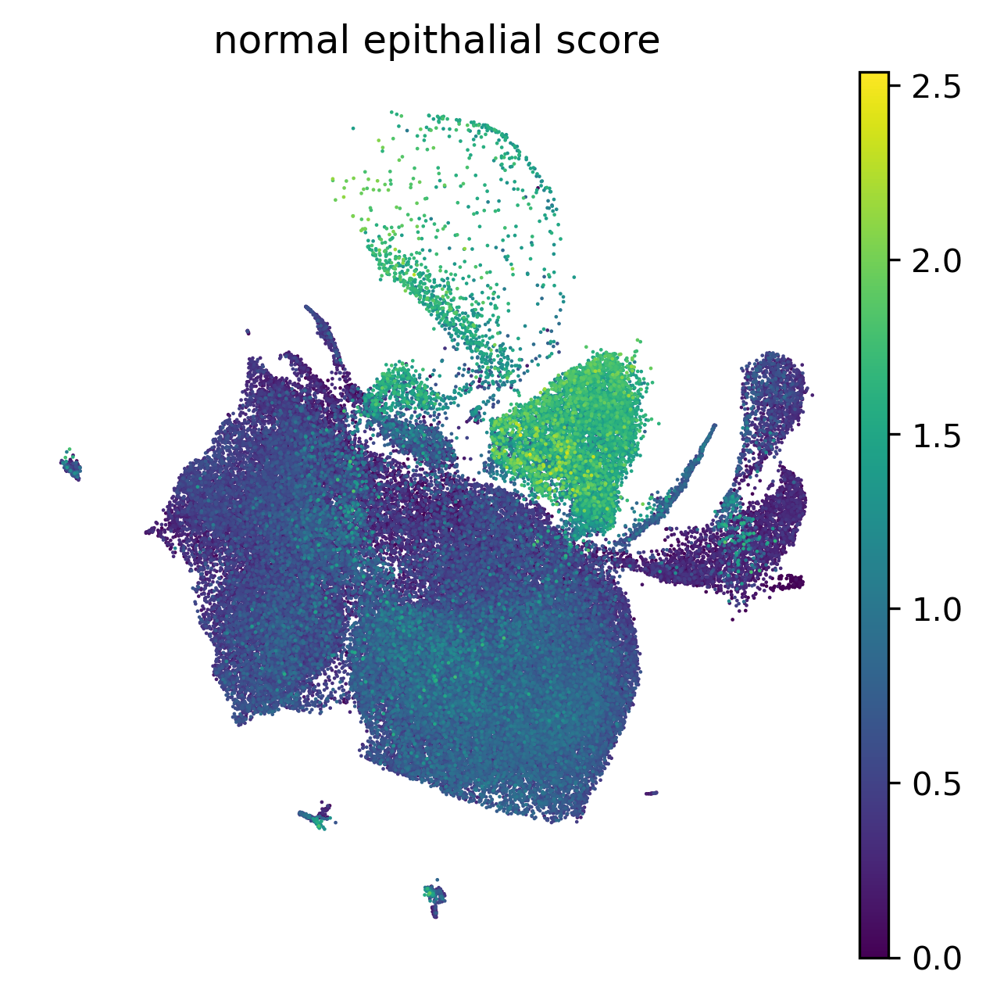

In [254]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(epi, color='normal epithalial score', ax=ax, size=5, save='epithelial_normal_epi_score.png',
          frameon=False)

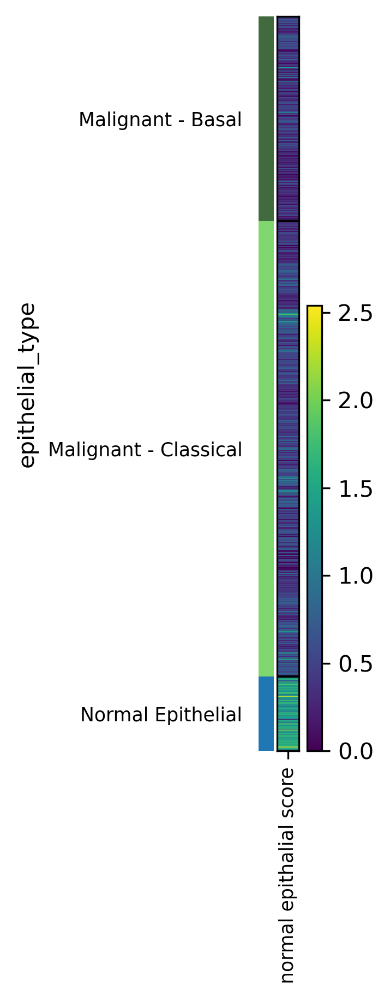

In [394]:
sc.pl.heatmap(epi, groupby='epithelial_type', var_names=['normal epithalial score'], save='epithelial_normal_epi_dotplot.pdf')

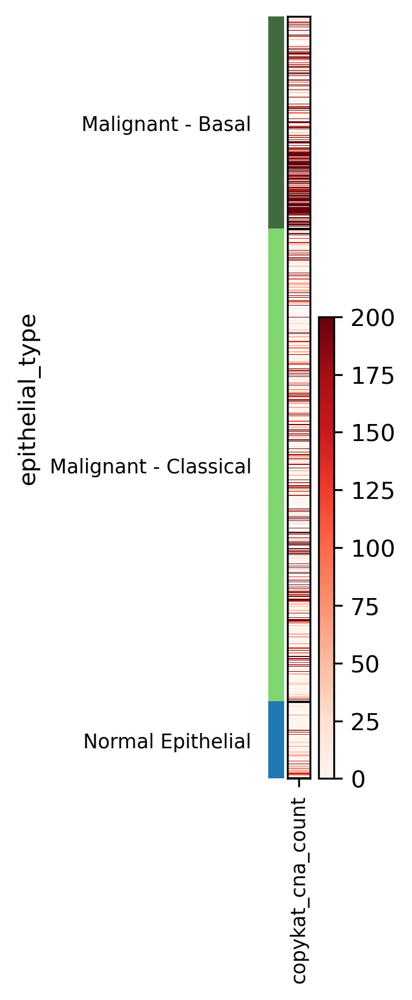

In [395]:
sc.pl.heatmap(epi, groupby='epithelial_type', var_names=['copykat_cna_count'], save='epithelial_cna_heatmap.pdf', vmax=200, cmap='Reds')


In [263]:
color_map = {ct:color
             for ct, color in zip(a.obs['cell_type_specific'].cat.categories, a.uns['cell_type_specific_colors'])}
malignant.uns['specific_cell_type_colors'] = [color_map.get(x, x)
                                              for x in malignant.obs['specific_cell_type'].cat.categories]

In [264]:
malignant.uns['specific_cell_type_colors']

['#416b3f', '#81d76f']

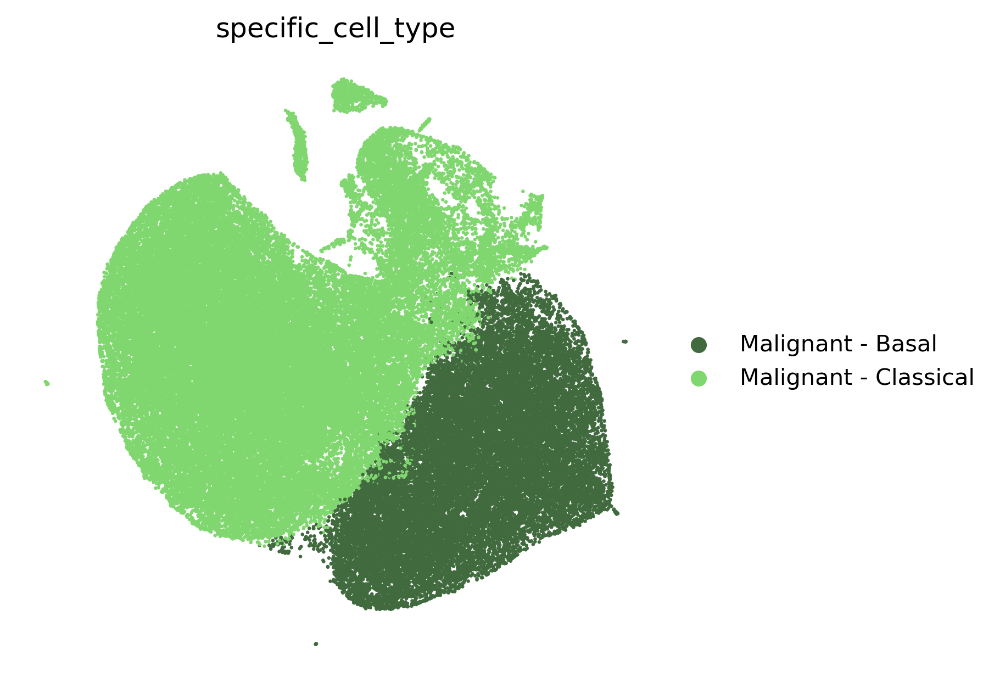

In [265]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(malignant, color='specific_cell_type', ax=ax, size=10, save='malignant_cell_type_specific.png',
          frameon=False)

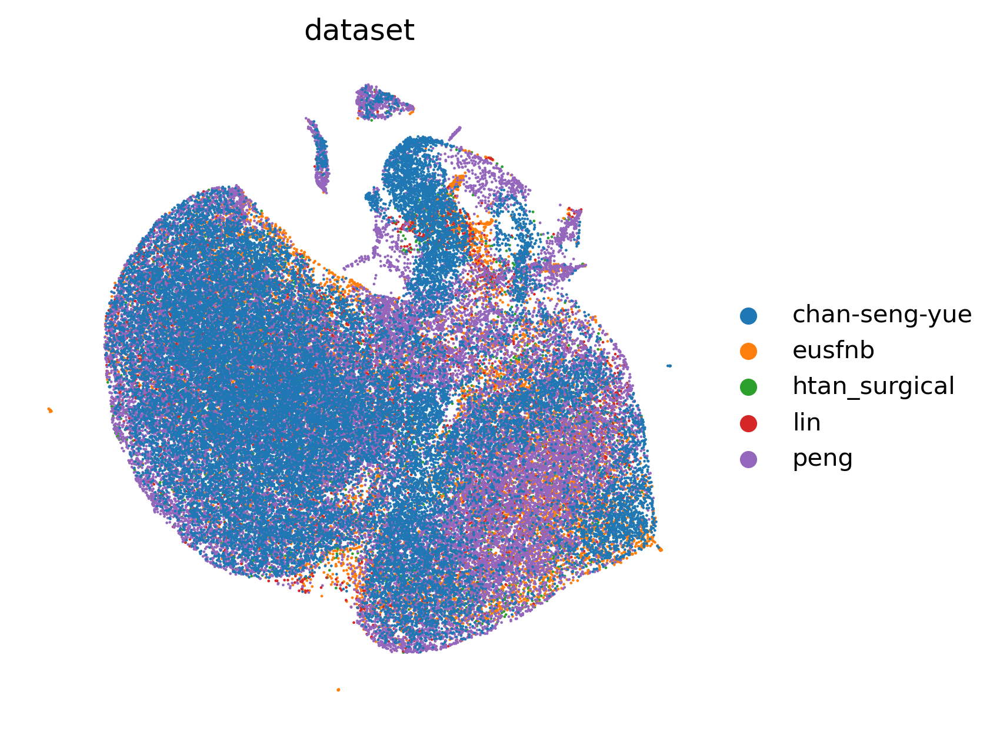

In [267]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(malignant, color='dataset', ax=ax, size=5, save='malignant_dataset.png', sort_order=False,
          frameon=False)

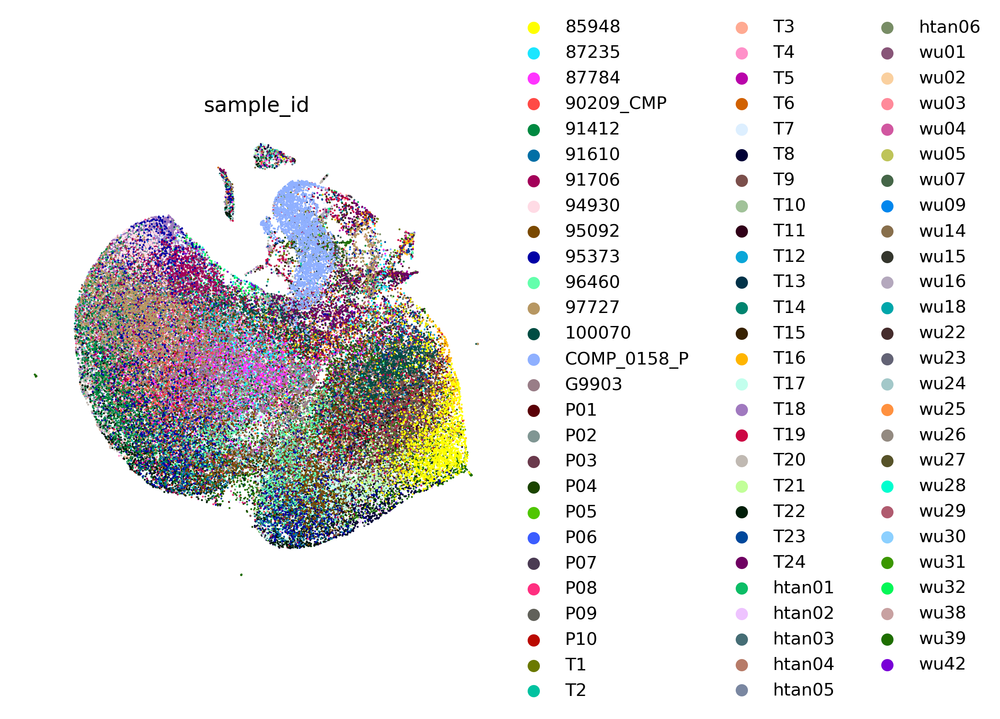

In [268]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(malignant, color='sample_id', ax=ax, size=5, save='malignant_sample_id.png', sort_order=False,
          frameon=False)

In [341]:
import altair as alt
def fractions_barplot(df, x, y, colors=None, sort_fraction=False):
    data = []
    x_order = sorted(set(df[x]))
    y_order = sorted(set(df[y]))
    for i in x_order:
        f = df[df[x]==i]
        counts = Counter(f[y])
        for j in y_order:
            data.append([i, j, counts[j] / f.shape[0]])
    source = pd.DataFrame(data=data, columns=[x, y, 'fraction'])
    if colors is not None:
        source['color'] = [colors[v] for v in source[y]]
        
    if sort_fraction:
        v = y_order[0]
        frac = source[source[y]==v]
        x_order = np.flip(frac.sort_values('fraction')[x].to_list())
    
    chart = alt.Chart(source).mark_bar().encode(
        x=alt.X(x, sort=x_order),
        y='fraction',
        color=y if colors is None else alt.Color('color', scale=None)
    ).configure_axis(
        grid=False
    )
    return chart

In [342]:
colors = {ct:c for ct, c in zip(malignant.obs['specific_cell_type'].cat.categories,
                                malignant.uns['specific_cell_type_colors'])}
fractions_barplot(malignant.obs, x='dataset', y='specific_cell_type', colors=colors)

alt.Chart(...)

In [343]:
fractions_barplot(malignant.obs, x='dataset', y='specific_cell_type', colors=colors, sort_fraction=True)

alt.Chart(...)

In [280]:
score_map = {
    'Basal': ['Moffit | Basal score', 'raghaven | scBasal score', 'Collison | Quasi-Mesenchymal score', 'Bailey | Squamous-like score', 'Chan-Seng-Yue | Signature 2 (Basal-like A) score', 'Chan-Seng-Yue | Signature 10 (Basal-like B) score',],
    'Classical': ['Moffit | Classical score', 'raghaven | scClassical score', 'Collison | Classical score', 'Bailey | Pancreatic-Progenitor score', 'Chan-Seng-Yue | Signature 1 (Classical A) score', 'Chan-Seng-Yue | Signature 6 (Classical B) score',],
    'CAF': ['elyada | myCAF score', 'elyada | iCAF score'],
    'TAM': ['raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score'],
    'T cell': ['CD3G'],
    'CD4 T': ['IL7R', 'CD4'],
    'CD8 T': ['CD8A', 'GZMK'],
    'Treg': ['FOXP3'],
    'NK': ['NKG7'],
    'Exhaustion': ['LAG3', 'ITGAE'],
    'Proliferation': ['MKI67', 'TOP2A']
}


In [281]:
# for score in [s for k, vs in score_map.items()
#                for s in vs
#               if k in ['Basal', 'Classical']
#              ]:
#     malignant.obs[score] = a[malignant.obs.index].obs[score]

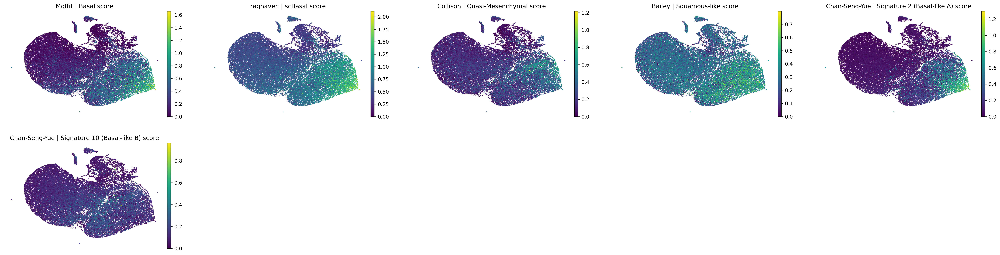

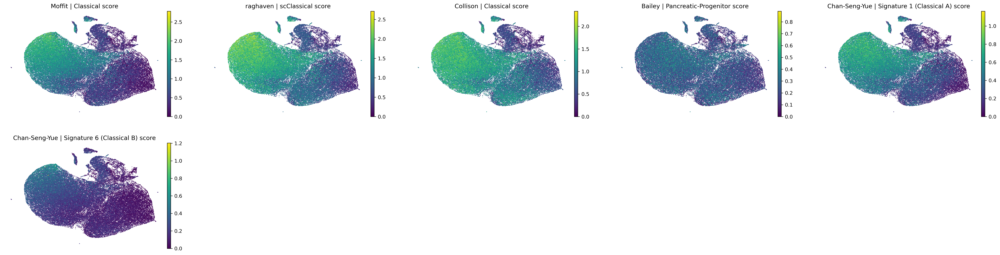

In [283]:
for k, ls in score_map.items():
    if k in ['Basal', 'Classical']:
        sc.pl.umap(malignant, color=ls, size=5, save=f'malignant_subtypes_{k}.png', ncols=5, frameon=False)
        plt.show()


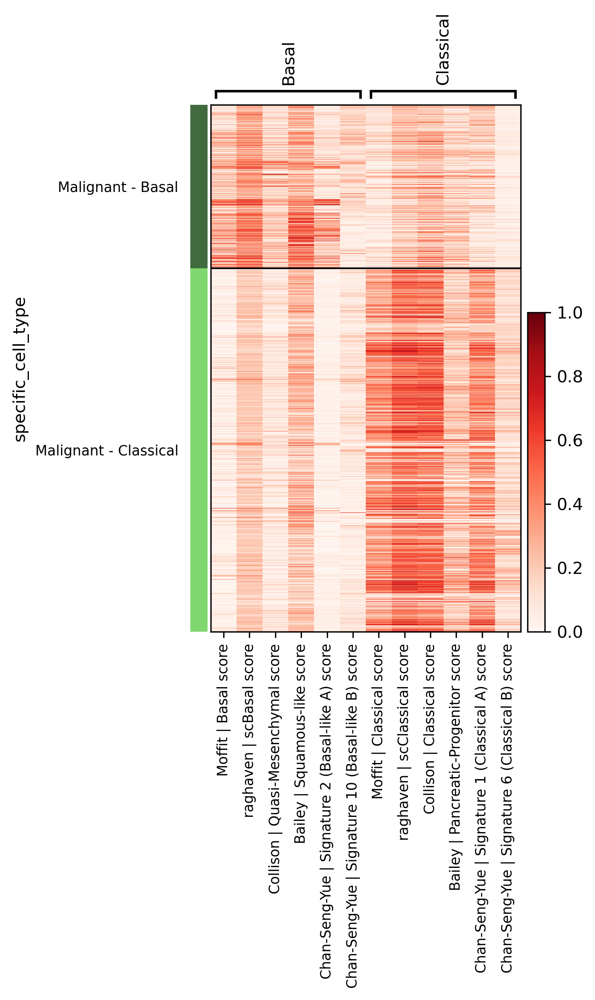

In [286]:
sc.pl.heatmap(malignant, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['Basal', 'Classical']},
                 standard_scale='var', save=f'malignant_subtypes_heatmap.png', cmap='Reds')

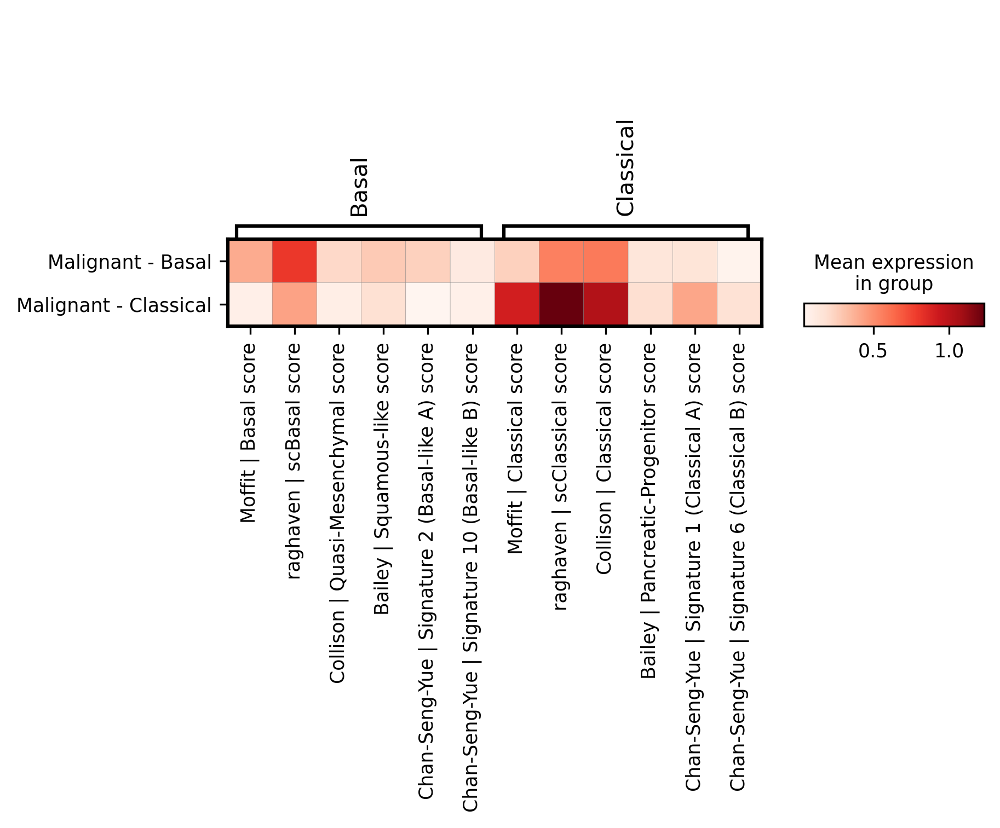

In [288]:
sc.pl.matrixplot(malignant, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['Basal', 'Classical']}, cmap='Reds',
                save='malignant_subtypes_matrixplot.pdf')

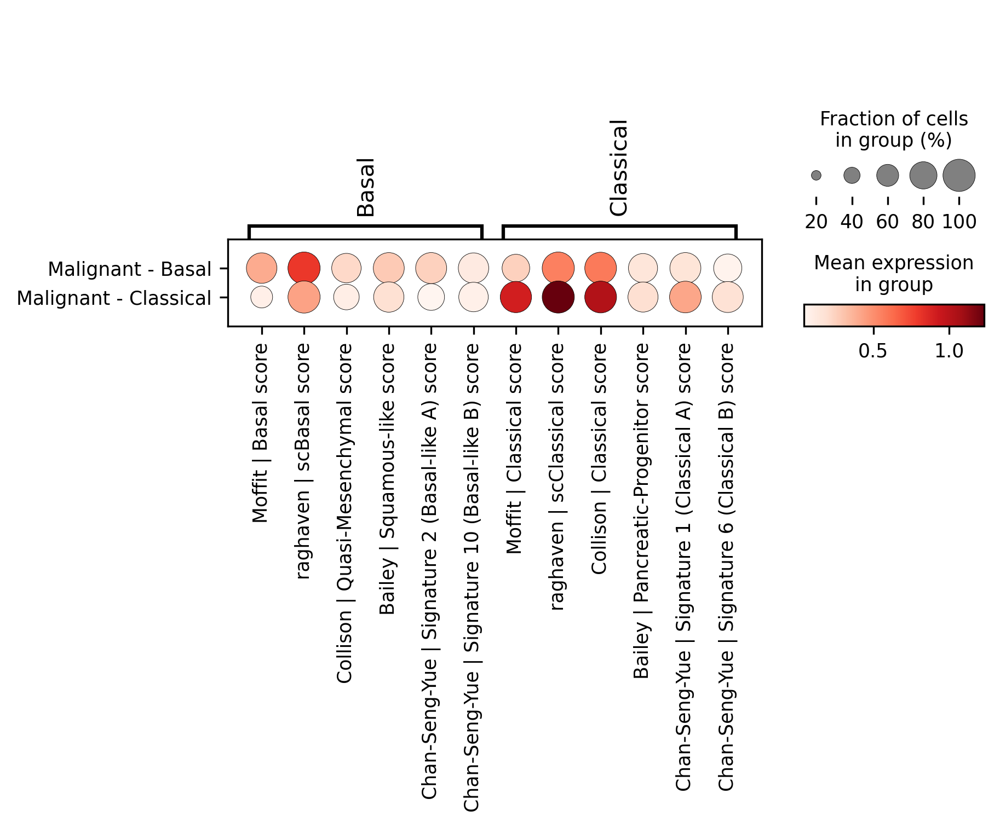

In [289]:
sc.pl.dotplot(malignant, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['Basal', 'Classical']},
                cmap='Reds', save='malignant_subtypes_dotplot.pdf')

#### caf

In [290]:
caf = sc.read_h5ad('../data/single_cell/annotated/fibroblast_annotations.h5ad')
caf = caf[caf.obs['specific_cell_type']!='doublet']

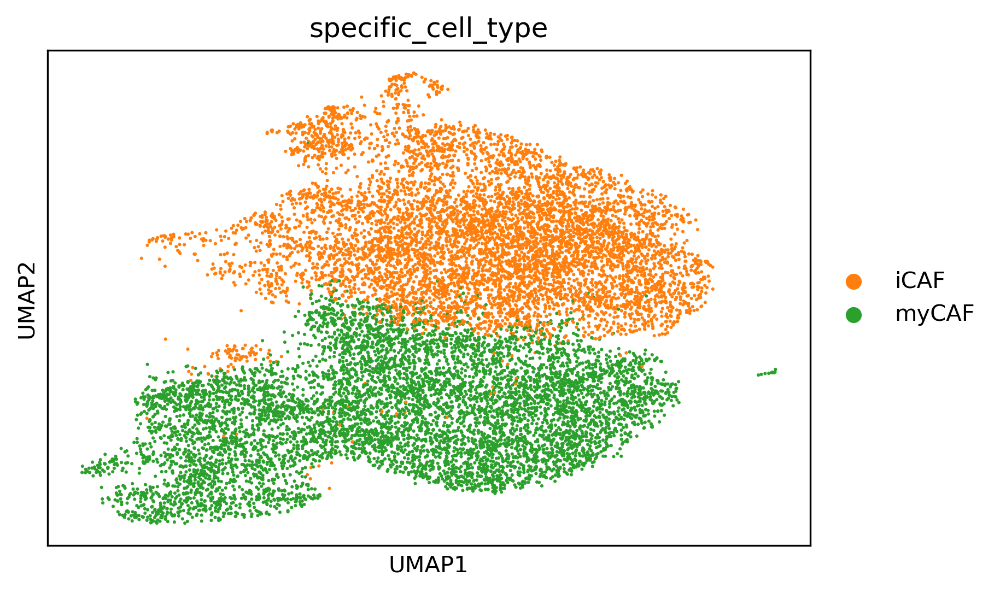

In [291]:
sc.pl.umap(caf, color='specific_cell_type')

In [292]:
color_map = {ct:color
             for ct, color in zip(a.obs['cell_type_specific'].cat.categories, a.uns['cell_type_specific_colors'])}
caf.uns['specific_cell_type_colors'] = [color_map.get(x, x)
                                              for x in caf.obs['specific_cell_type'].cat.categories]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


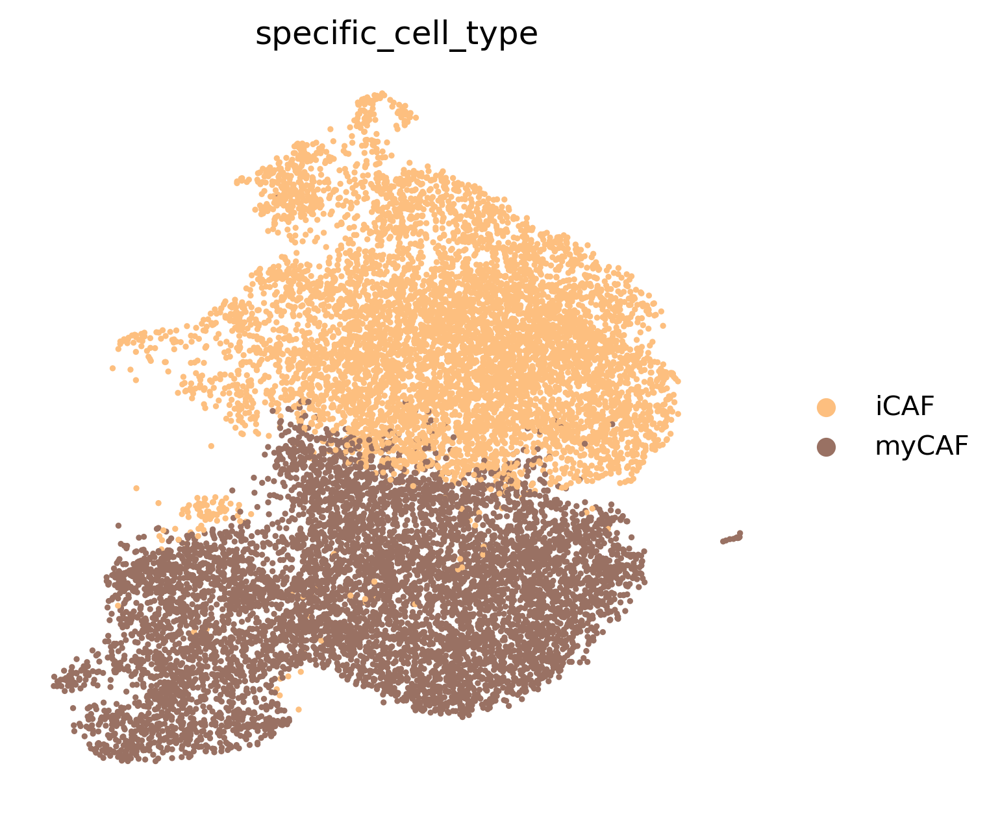

In [362]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(caf, color='specific_cell_type', ax=ax, size=20, save='caf_cell_type_specific.png', frameon=False)

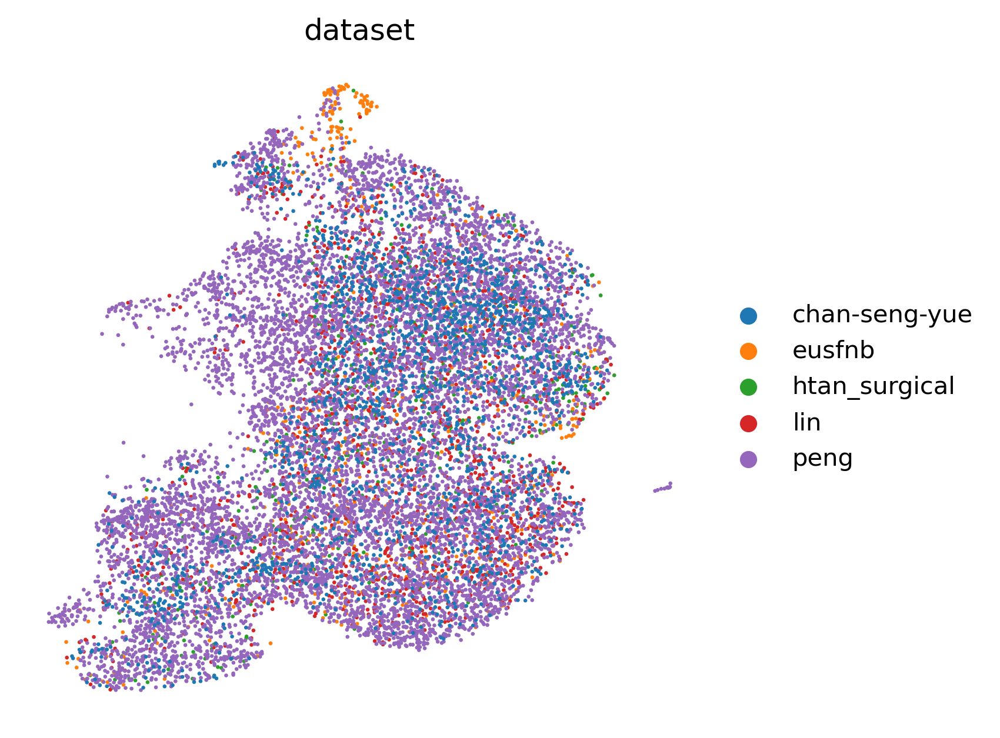

In [294]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(caf, color='dataset', ax=ax, size=10, save='caf_dataset.png', frameon=False)

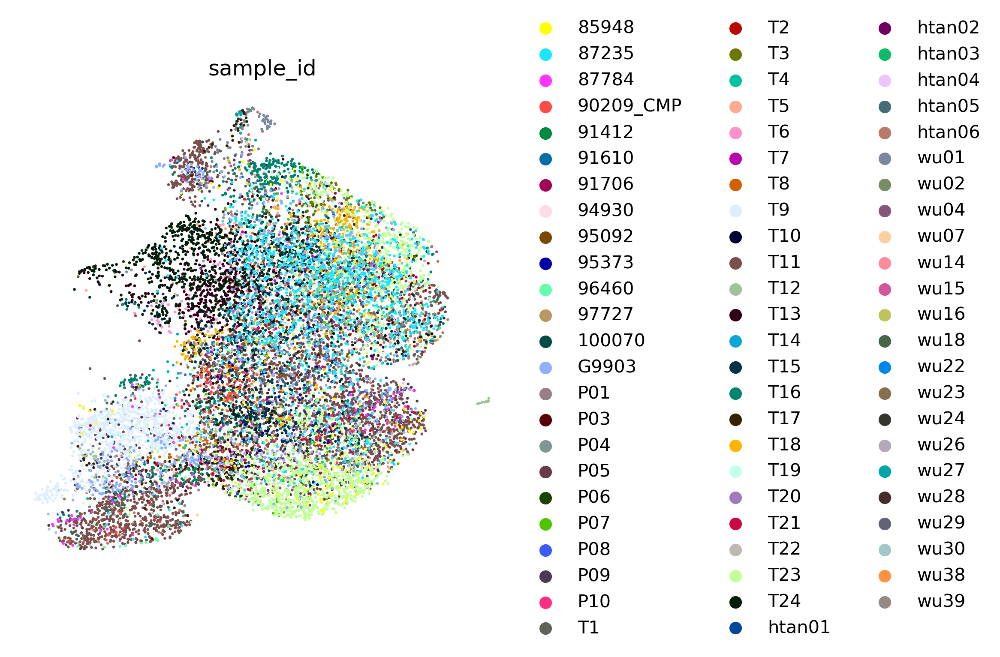

In [295]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(caf, color='sample_id', ax=ax, size=10, save='caf_sample_id.png', frameon=False)

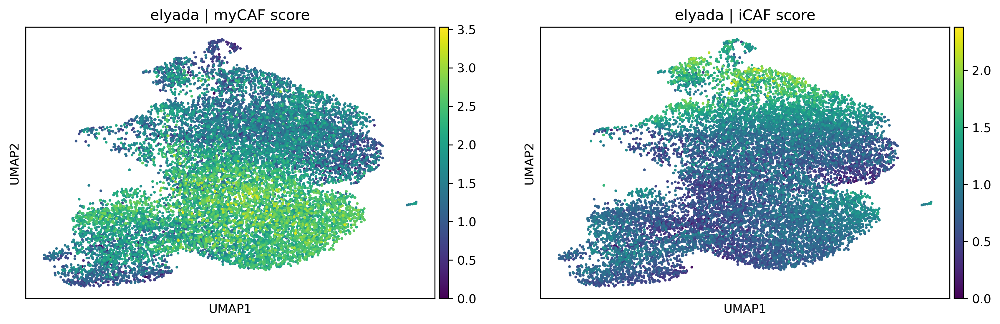

In [296]:
for k, ls in score_map.items():
    if k in ['CAF']:
        sc.pl.umap(caf, color=ls, size=20, save=f'caf_subtypes_{k}.png', ncols=5)
        plt.show()


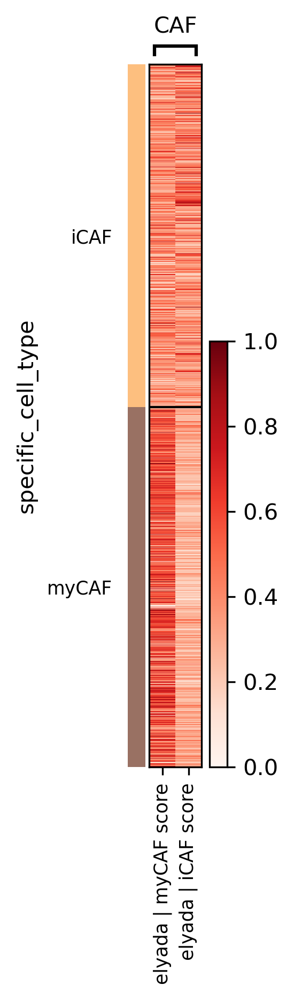

In [297]:
sc.pl.heatmap(caf, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['CAF']},
                 standard_scale='var', save=f'caf_subtypes_heatmap.png', cmap='Reds')

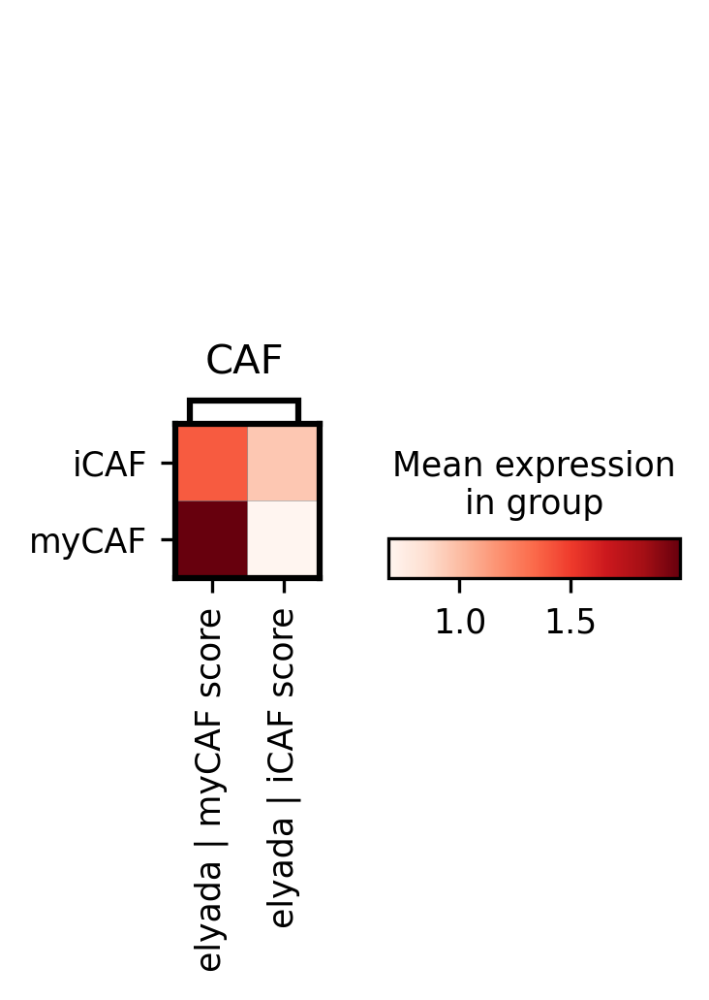

In [298]:
sc.pl.matrixplot(caf, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['CAF']},
                save='caf_subtypes_matrixplot.pdf', cmap='Reds')

In [ ]:
sc.pl.dotplot(caf, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['CAF']},
                save='caf_subtypes_dotplot.pdf', cmap='Reds')

In [344]:
colors = {ct:c for ct, c in zip(caf.obs['specific_cell_type'].cat.categories,
                                caf.uns['specific_cell_type_colors'])}
fractions_barplot(caf.obs, x='dataset', y='specific_cell_type', colors=colors)

alt.Chart(...)

In [345]:

fractions_barplot(caf.obs, x='sample_id', y='specific_cell_type', colors=colors, sort_fraction=True)

alt.Chart(...)

#### tam

In [322]:
tam = sc.read_h5ad('../data/single_cell/annotated/monocyte_annotations.h5ad')
tam = tam[[False if x in ['DC', 'pDC', 'TAM - proliferating', 'doublet'] else True
           for x in tam.obs['specific_cell_type']]]

In [ ]:
sc.pl.umap(tam, color='specific_cell_type')

In [324]:
color_map = {ct:color
             for ct, color in zip(a.obs['cell_type_specific'].cat.categories, a.uns['cell_type_specific_colors'])}
tam.uns['specific_cell_type_colors'] = [color_map.get(x, x)
                                              for x in tam.obs['specific_cell_type'].cat.categories]

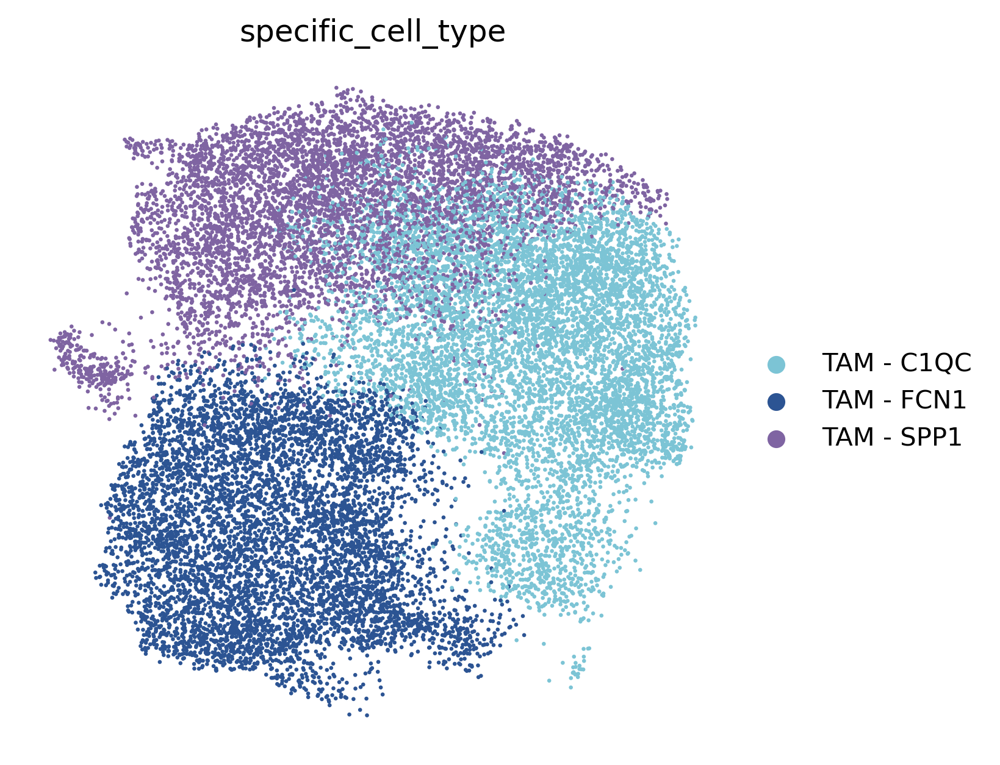

In [325]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(tam, color='specific_cell_type', ax=ax, size=10, save='tam_cell_type_specific.png', frameon=False)

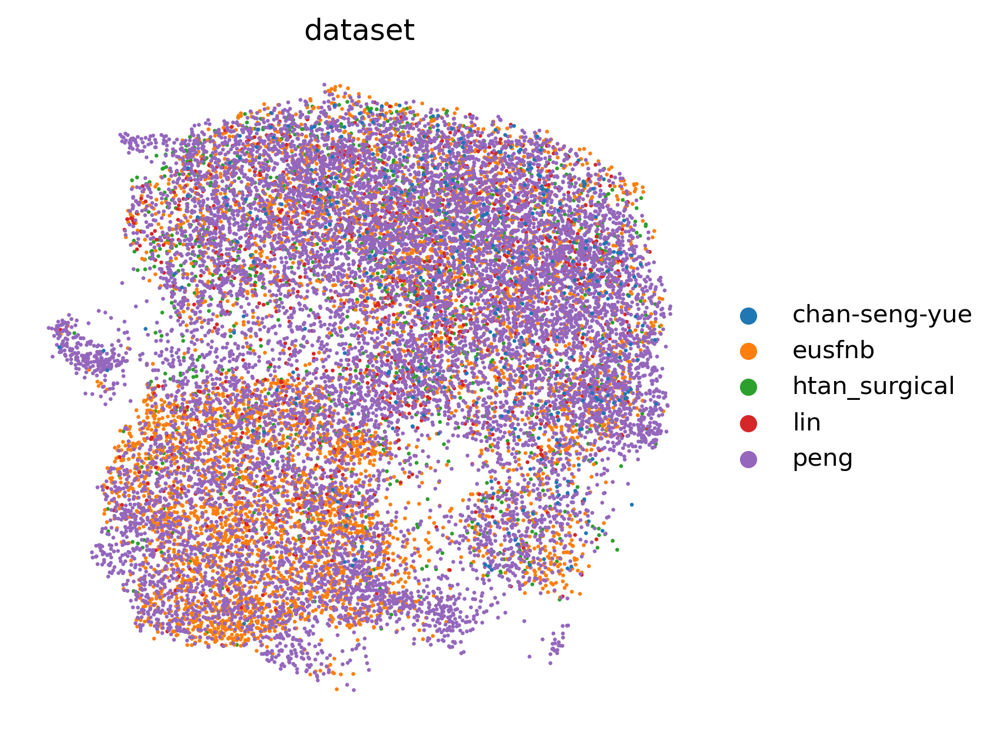

In [326]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(tam, color='dataset', ax=ax, size=10, save='tam_dataset.png', frameon=False)

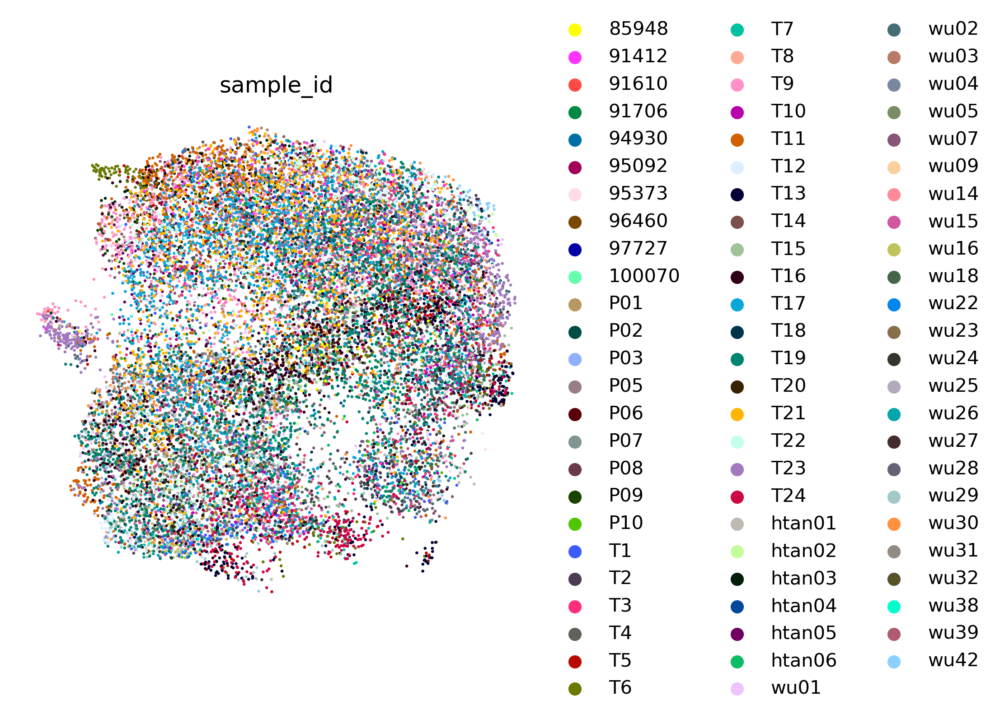

In [346]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(tam, color='sample_id', ax=ax, size=10, save='tam_sample_id.png', frameon=False)

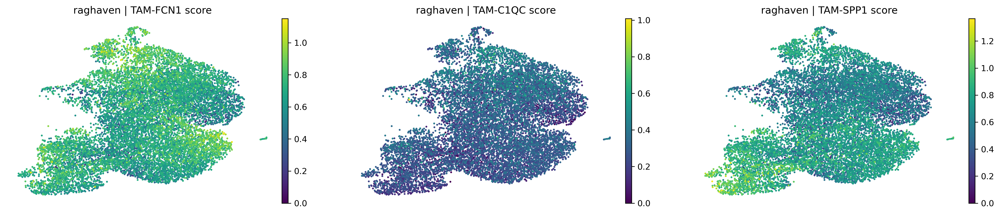

In [348]:
for k, ls in score_map.items():
    if k in ['TAM']:
        sc.pl.umap(caf, color=ls, size=20, save=f'tam_subtypes_{k}.png', ncols=5, frameon=False)
        plt.show()


In [ ]:
sc.pl.heatmap(tam, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['TAM']},
                 standard_scale='var', save=f'tam_subtypes_heatmap.png', cmap='Reds')

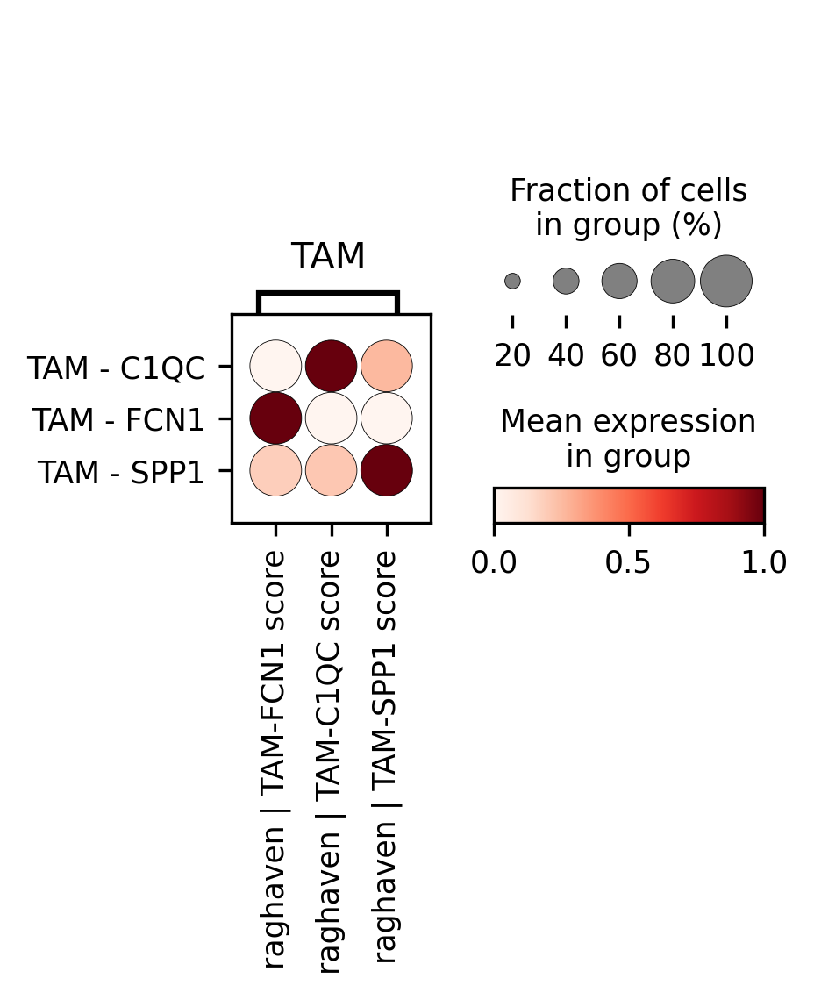

In [350]:
sc.pl.dotplot(tam, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['TAM']},
                 standard_scale='var', save=f'tam_subtypes_dotplot.pdf', cmap='Reds')

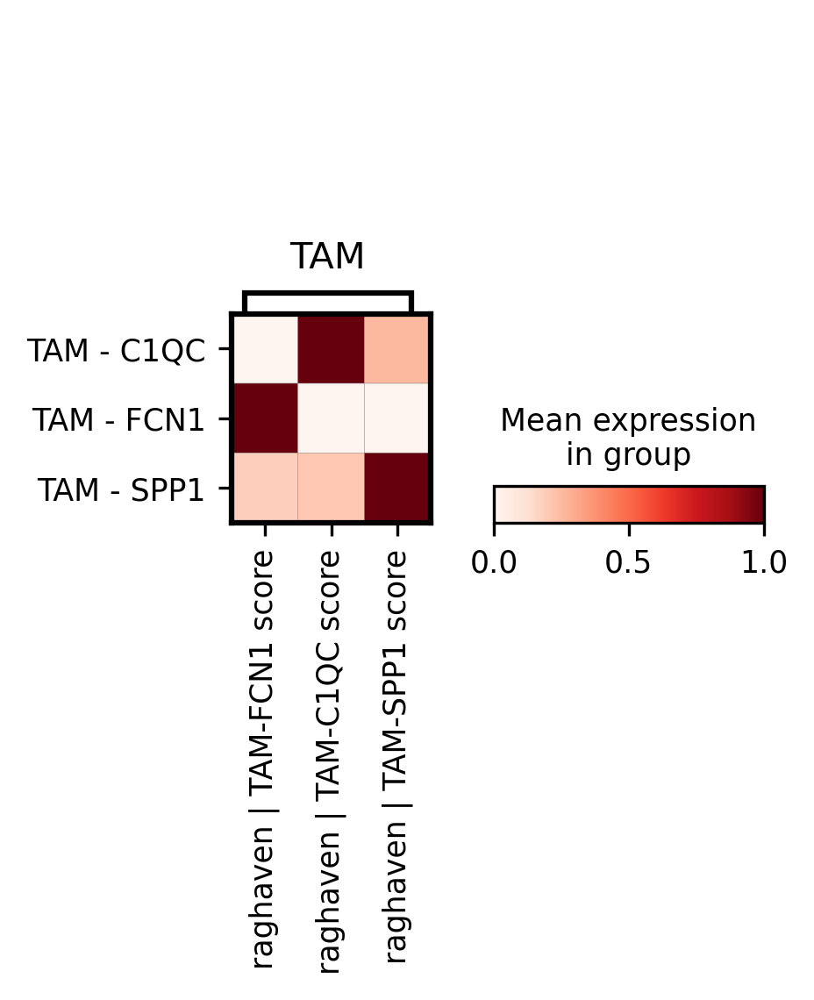

In [351]:
sc.pl.matrixplot(tam, groupby='specific_cell_type', var_names={k:v for k, v in score_map.items()
                                                                 if k in ['TAM']},
                 standard_scale='var', save=f'tam_subtypes_matrixplot.pdf', cmap='Reds')

In [390]:
colors = {ct:c for ct, c in zip(tam.obs['specific_cell_type'].cat.categories,
                                tam.uns['specific_cell_type_colors'])}
fractions_barplot(tam.obs, x='dataset', y='specific_cell_type', colors=colors)

alt.Chart(...)

In [352]:
tam.uns.pop('log1p')
sc.tl.rank_genes_groups(tam, groupby='specific_cell_type')

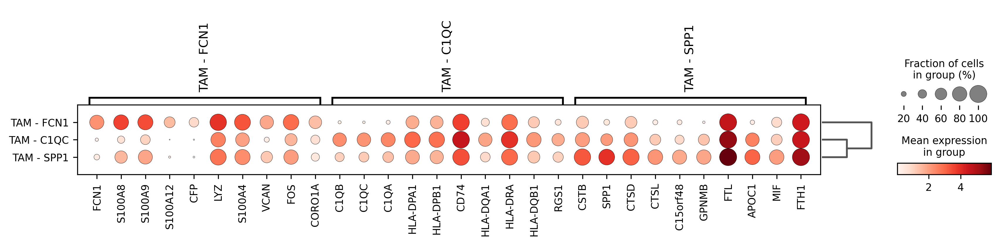

In [353]:
sc.pl.rank_genes_groups_dotplot(tam)

In [354]:
genes = tam.uns['rank_genes_groups']['names']['TAM - SPP1'][:20]
df = een.get_pathway_enrichment(genes, gene_set_library='GO_Biological_Process_2021')
epl.enrichment_dotplot(df, n=20, hue='Z-score', log=True)

alt.LayerChart(...)

#### CAF differential

In [396]:
keep = [
    'iCAF', 'myCAF'
]
f = a[[True if ct in keep else False for ct in a.obs['cell_type_specific']]]
f

View of AnnData object with n_obs × n_vars = 13807 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets scor

In [398]:
f.uns.pop('log1p')
sc.tl.rank_genes_groups(f, groupby='cell_type_specific')

In [399]:
genes = f.uns['rank_genes_groups']['names']['myCAF'][:20]
df = een.get_pathway_enrichment(genes, gene_set_library='GO_Biological_Process_2021')
epl.enrichment_dotplot(df, n=10, hue='Z-score', log=True)

alt.LayerChart(...)

In [400]:
list(zip(df['Term name'], df['Overlapping genes']))

[('extracellular matrix organization (GO:0030198)',
  ['COL1A1',
   'GREM1',
   'MMP11',
   'POSTN',
   'MMP14',
   'COL11A1',
   'COL12A1',
   'COL5A2',
   'FN1',
   'COL10A1',
   'LOXL2']),
 ('collagen fibril organization (GO:0030199)',
  ['COL1A1', 'GREM1', 'COL11A1', 'COL12A1', 'COL5A2', 'COL10A1', 'LOXL2']),
 ('extracellular structure organization (GO:0043062)',
  ['COL1A1',
   'MMP11',
   'POSTN',
   'MMP14',
   'COL11A1',
   'COL5A2',
   'FN1',
   'COL10A1']),
 ('external encapsulating structure organization (GO:0045229)',
  ['COL1A1',
   'MMP11',
   'POSTN',
   'MMP14',
   'COL11A1',
   'COL5A2',
   'FN1',
   'COL10A1']),
 ('endodermal cell differentiation (GO:0035987)',
  ['MMP14', 'COL11A1', 'COL12A1', 'FN1', 'INHBA']),
 ('endoderm formation (GO:0001706)',
  ['MMP14', 'COL11A1', 'COL12A1', 'FN1', 'INHBA']),
 ('supramolecular fiber organization (GO:0097435)',
  ['COL1A1', 'GREM1', 'COL11A1', 'COL12A1', 'COL5A2', 'COL10A1', 'LOXL2']),
 ('regulation of epithelial to mesenchymal 

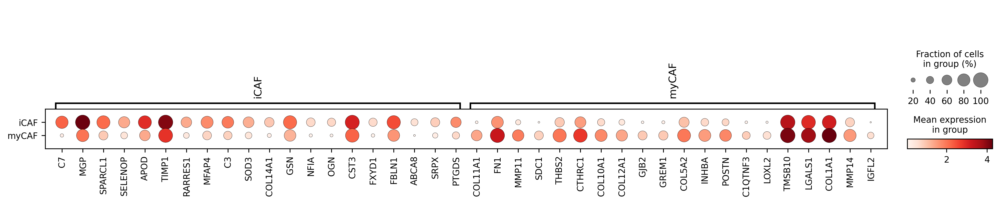

In [403]:
sc.pl.rank_genes_groups_dotplot(f, n_genes=20, save='caf_degs_dotplot.pdf')

#### cytotrace

In [385]:
caf = sc.read_h5ad('../data/single_cell/annotated/fibroblast_annotations.h5ad')
caf

AnnData object with n_obs × n_vars = 14877 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets score', 'ben

In [383]:
df = pd.read_csv('../data/cytotrace/fibroblast_cytotrace_results.csv', index_col=0)
df['cell_id'] = [x[1:].replace('.1', '-1') for x in df.index]
df = df.set_index('cell_id')
df

,CytoTRACE,CytoTRACErank,GCS,Counts,Sample,Dataset,Tissue,CellType,State,ID
cell_id,,,,,,,,,,
P04_TCAACGATCCCTTGTG-1,0.125510,130.0,0.577260,429,XP04,lin,tumor_primary,Fibroblast,iCAF,XP04_TCAACGATCCCTTGTG.1
P05_CCTACACGTAGCTAAA-1,0.688776,682.0,2.164932,2902,XP05,lin,tumor_primary,Fibroblast,iCAF,XP05_CCTACACGTAGCTAAA.1
P05_ATTGGACAGCGTAATA-1,0.203061,206.0,1.077097,1648,XP05,lin,tumor_primary,Fibroblast,iCAF,XP05_ATTGGACAGCGTAATA.1
P01_TCCTACCTACGACT-1,0.883673,873.0,1.810855,1773,XP01,lin,tumor_primary,Fibroblast,iCAF,XP01_TCCTACCTACGACT.1
P05_CATCCACTCACCCGAG-1,0.226531,229.0,0.881190,996,XP05,lin,tumor_primary,Fibroblast,iCAF,XP05_CATCCACTCACCCGAG.1
...,...,...,...,...,...,...,...,...,...,...
T24_TGCCAAAAGTTAACGA-1,0.292857,294.0,1.806713,3124,XT24,peng,tumor_primary,Fibroblast,iCAF,XT24_TGCCAAAAGTTAACGA.1
T23_CATCGAATCATAACCG-1,0.750000,742.0,2.228222,2898,XT23,peng,tumor_primary,Fibroblast,myCAF,XT23_CATCGAATCATAACCG.1
T17_ACACCCTCATGTCCTC-1,0.422449,421.0,1.772337,1778,XT17,peng,tumor_primary,Fibroblast,myCAF,XT17_ACACCCTCATGTCCTC.1


In [386]:
caf = caf[df.index.to_list()]
caf

View of AnnData object with n_obs × n_vars = 13807 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets scor

In [387]:
caf.obs['CytoTRACE'] = df['CytoTRACE']

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
sc.pl.umap(caf, color='CytoTRACE', ax=ax, size=10, save='cytotrace_caf.png', frameon=False)

In [ ]:
sns.boxplot(data=df, x='State', y='CytoTRACE')

#### ecotyper

In [373]:
clinical = pd.read_csv('../data/clinical/clinical.txt', sep='\t')
clinical = clinical.set_index('sample_id')
clinical

,age,gender,survival,status,dataset
sample_id,,,,,
SA518851,67.0,male,5.0,Dead,bailey
SA528766,61.0,female,8.0,Dead,bailey
SA528763,52.0,male,36.0,Dead,bailey
SA518854,55.0,male,5.0,Alive,bailey
SA518806,51.0,female,14.0,Dead,bailey
...,...,...,...,...,...
T_11_02_A148a,68.0,male,20.0,Dead,kirby
T_11_04_A026b,64.0,female,49.0,Alive,kirby
T_11_05_A018b,76.0,male,36.0,Dead,kirby


In [375]:
clinical.loc['TCGA-2J-AABV']

age         74.0
gender      male
survival    21.0
status      Dead
dataset     tcga
Name: TCGA-2J-AABV, dtype: object

In [366]:
eco = pd.read_csv('../results/ecotyper/Test_18_New_scRNA_Seq_Object_Discovered_States_PDSM_102322/Ecotypes/ecotypes.txt',
                 sep='\t')
eco

,CellType,State,InitialEcotype,ID,Cell type,Ecotype
0,Plasma,S01,IE01,Plasma_S01,Plasma,E1
1,Mast,S01,IE01,Mast_S01,Mast,E1
2,Bcell,S02,IE01,Bcell_S02,Bcell,E1
3,Platelets,S02,IE01,Platelets_S02,Platelets,E1
4,Endothelial,S02,IE01,Endothelial_S02,Endothelial,E1
5,Erythrocyte,S01,IE01,Erythrocyte_S01,Erythrocyte,E1
6,MonocyteDC,TAMFCN1,IE01,MonocyteDC_TAMFCN1,MonocyteDC,E1
7,Plasma,S04,IE02,Plasma_S04,Plasma,E2
8,Acinar,S05,IE02,Acinar_S05,Acinar,E2
9,NKTcell,CD8TcellExhausted,IE02,NKTcell_CD8TcellExhausted,NKTcell,E2


In [376]:
bulk = pd.read_csv('../results/ecotyper/Test_18_New_scRNA_Seq_Object_Discovered_States_PDSM_102322/All_Bulk_Recovery_102922/Ecotypes/ecotype_assignment.txt',
                  sep='\t')
bulk.index = [x.replace('.', '-') for x in bulk['ID']]
bulk = bulk[['Ecotype', 'age', 'gender', 'race', 'tumor_stage', 'survival_time', 'status', 'dataset']]
bulk

,Ecotype,age,gender,race,tumor_stage,survival_time,status,dataset
TCGA-2J-AABV,E1,74.0,male,white,stage iib,21,1,tcga
TCGA-IB-8126,E1,80.0,female,white,stage iii,15,0,tcga
TCGA-LB-A9Q5,E1,63.0,female,white,stage iib,10,1,tcga
SA408758,E2,51.0,male,unknown,unknown,25,1,bailey
SA410118,E2,82.0,female,unknown,unknown,13,1,bailey
...,...,...,...,...,...,...,...,...
TCGA-S4-A8RM,E4,67.0,male,white,stage iib,24,0,tcga
TCGA-US-A779,E4,54.0,female,white,stage iib,16,1,tcga
TCGA-XD-AAUG,E4,66.0,female,white,stage iv,13,0,tcga
TCGA-YY-A8LH,E4,61.0,female,white,stage iib,66,0,tcga


In [377]:
from lifelines import KaplanMeierFitter, CoxPHFitter

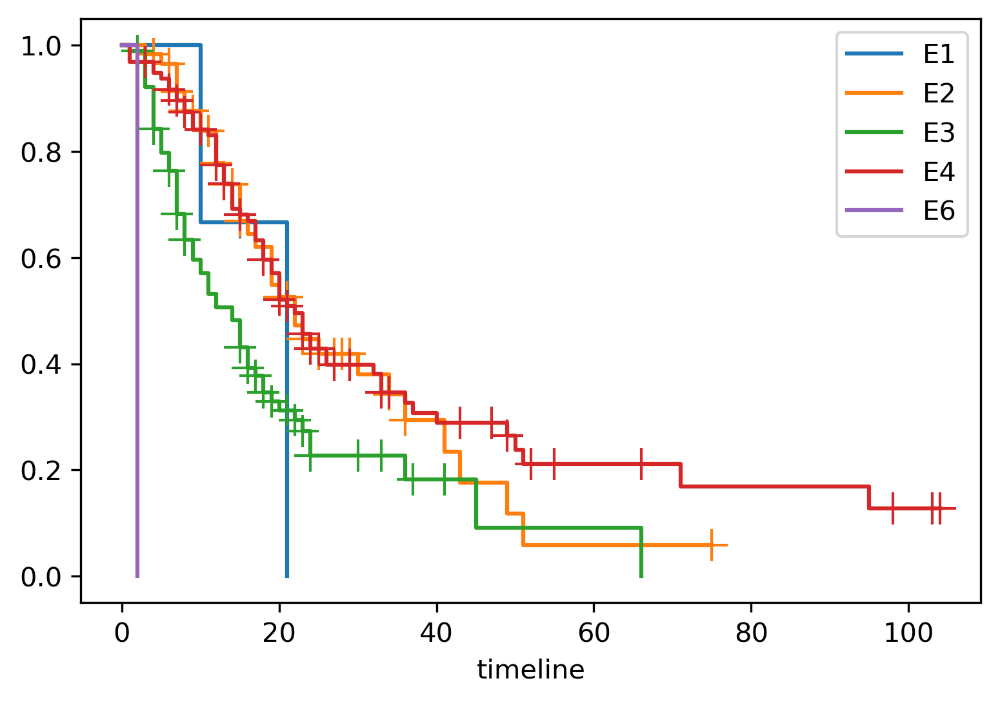

In [380]:
kmf = KaplanMeierFitter()
ft = bulk.copy()
# ft = ft[ft['survival_time']<50]
T = ft['survival_time']
E = ft['status']
groups = ft['Ecotype']

clusters = sorted(set(ft['Ecotype']))
for cluster in clusters: 
    kmf.fit(T[groups==cluster], E[groups==cluster], label=cluster)
    ax = kmf.plot(show_censors=True, ci_show=False,)
plt.savefig(os.path.join(fig_dir, 'survival_ecotypes_km.pdf'))

In [ ]:
result = None
cs = sorted(set(ft['ecotype']))
for cluster in cs:
    ft = combined.obs.copy()
    df = ft[['survival_time', 'status']]
    df['event'] = df['status'] == 'Dead'
    df[community] = [True if x == cluster False for x in ft['ecotype']]
    
    cph = CoxPHFitter()
    cph.fit(df, duration_col='survival_time', event_col='event')
    r = cph.summary[['coef', 'z', 'p', '-log2(p)']]
    if result is None:
        result = r
    else:
        result = pd.concat((result, r))
result

In [ ]:
source = result.sort_values('z')
source['Ecotype'] = source.index.to_list()
c = alt.Chart(source).mark_bar().encode(
    y=alt.Y('Ecotype', sort='-color'),
    x=alt.X('-log2(p)'),
    color=alt.Color('z', scale=alt.Scale(scheme='redblue', domain=[-2.5, 2.5]))
)
line = alt.Chart(pd.DataFrame({'x': [4.32]})).mark_rule(color='gray', strokeDash=[4,1]).encode(x='x')
# line = alt.Chart(pd.DataFrame({'x': [4.32]})).mark_rule(color='gray', strokeDash=[4,1]).encode(x='x')

c + line

In [408]:
gene_sets = json.load(open('../data/single_cell/gene_sets/pdac_gene_sets.json'))
gene_sets['luoma'] = {f'{k1} - {k2}':v2 for k1, v1 in gene_sets['luoma'].items() for k2, v2 in v1.items()}

for k, v in gene_sets.items():
    for k2, v2 in v.items():
        print(k, k2, len(v2), ', '.join(v2[:50]))
        print()

Bailey ADEX 20 MTMR7, ARX, ABCC8, CEACAM7, CACNA2D2, MAPK8IP2, SYT7, LTF, NR1H4, SLC7A14, PRSS3, CPA1, AQP8, FGL1, SERPINI2, REG1A, NR5A2, RBPJL, KIRREL2, CLPS

Bailey Squamous-like 20 CFH, CD99, HECW1, PLXND1, RECQL, C1orf112, M6PR, FKBP4, GGCT, DBF4, SEMA3F, ANKIB1, MAD1L1, CDC27, WDR54, DPM1, NME2, UTP18, SLC25A39, TTC27

Bailey Pancreatic-Progenitor 20 ENPP4, CFTR, CYP51A1, ABP1, LASP1, TMEM176A, ICA1, DBNDD1, CASP10, SARM1, UPF1, ACSM3, SPPL2B, PDK2, OSBPL7, TMEM98, BAIAP2L1, ALDH3B1, TTC22, FARP2

Bailey Immunogenic 20 CD38, PDK4, FBXL3, CD79B, MYLIP, RWDD2A, ACPP, TRAF3IP3, ACAP1, ARHGAP15, CST7, P2RY10, SIRPG, GRAP2, FGR, ITGAL, CEACAM21, CD4, BTK, TYROBP

Collison Exocrine-like 20 REG1B, REG3A, REG1A, PNLIPRP2, CEL, PNLIP, PLA2G1B, CELA3A, CPB1, CELA3B, CTRB2, CLPS, CELA2B, PRSS2, PRSS1, GP2, SLC3A1, CFTR, SLC4A4, SPINK1

Collison Quasi-Mesenchymal 17 AIM2, CALHM6, GPM6B, S100A2, KRT14, CAV1, LOX, SLC2A3, TWIST1, PAPPA, NT5E, CKS2, HMMR, SLC5A3, PMAIP1, PHLDA1, SLC16A1

Collis

In [20]:
keep = [
    'iCAF', 'myCAF'
]
f = a[[True if ct in keep else False for ct in a.obs['cell_type_specific']]]
f

View of AnnData object with n_obs × n_vars = 13807 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets scor

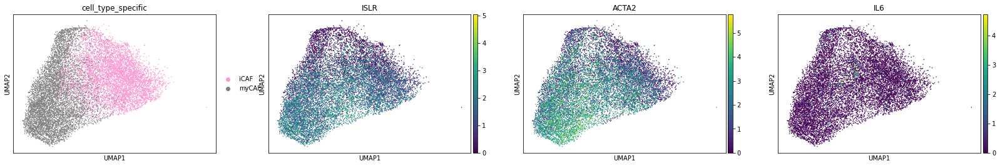

In [23]:
sc.pl.umap(f, color=['cell_type_specific', 'ISLR', 'ACTA2', 'IL6'])

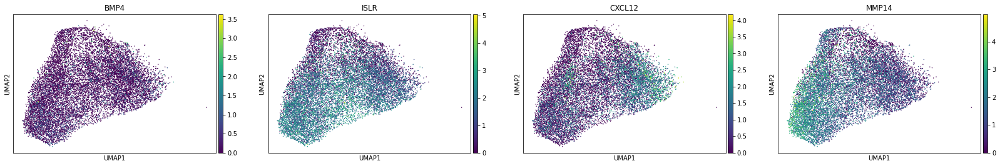

In [66]:
sc.pl.umap(f, color=['BMP4', 'ISLR', 'CXCL12', 'MMP14'])

In [32]:
sc.tl.rank_genes_groups(f, groupby='cell_type_specific')

In [36]:
sc.tl.rank_genes_groups(a, groupby='cell_type_specific')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/diskmnt/Projects/Users/estorrs/miniconda3/envs/sin

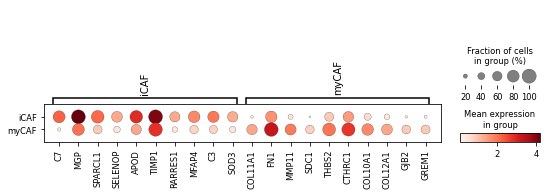

In [33]:
sc.pl.rank_genes_groups_dotplot(f)

categories: Acinar, B cell, CD4 T cell, etc.
var_group_labels: iCAF, myCAF


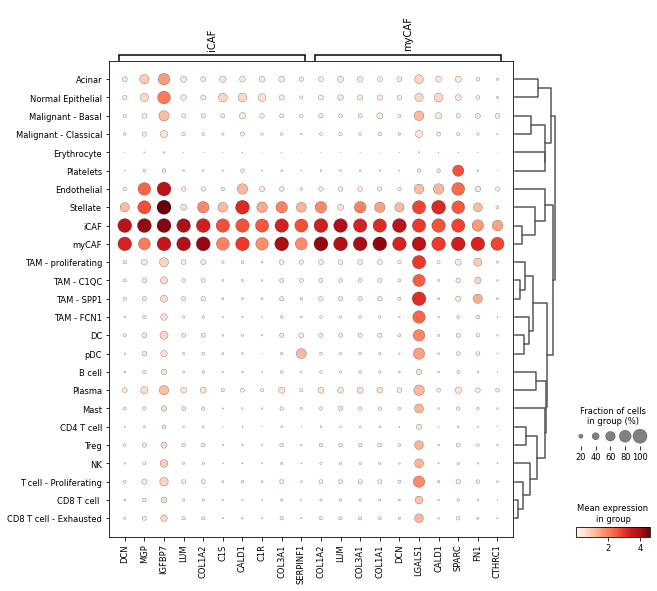

In [37]:
sc.pl.rank_genes_groups_dotplot(a, groups=['iCAF', 'myCAF'])

In [55]:
genes = f.uns['rank_genes_groups']['names']['iCAF'][:30]
df = een.get_pathway_enrichment(genes, gene_set_library='GO_Biological_Process_2021')
epl.enrichment_dotplot(df, n=20, hue='Z-score', log=True)

alt.LayerChart(...)

In [56]:
list(zip(df['Term name'].to_list(), df['Overlapping genes'].to_list()))

[('post-translational protein modification (GO:0043687)',
  ['C3', 'CST3', 'GPC3', 'SPARCL1', 'IGFBP7', 'TIMP1']),
 ('cellular protein metabolic process (GO:0044267)',
  ['C3', 'CST3', 'GPC3', 'SPARCL1', 'IGFBP7', 'TIMP1']),
 ('regulation of complement activation (GO:0030449)', ['C3', 'C7', 'C1R']),
 ('elastic fiber assembly (GO:0048251)', ['MFAP4', 'FBLN5']),
 ('regulation of immune effector process (GO:0002697)', ['C3', 'C7', 'C1R']),
 ('regulation of humoral immune response (GO:0002920)', ['C3', 'C7', 'C1R']),
 ('extracellular matrix organization (GO:0030198)',
  ['GSN', 'COL14A1', 'TIMP1', 'A2M', 'FBLN5']),
 ('negative regulation of peptidase activity (GO:0010466)',
  ['CST3', 'SERPINF1', 'TIMP1']),
 ('extracellular matrix disassembly (GO:0022617)', ['GSN', 'TIMP1', 'A2M']),
 ('cellular component disassembly (GO:0022411)', ['GSN', 'TIMP1', 'A2M']),
 ('supramolecular fiber organization (GO:0097435)',
  ['CST3', 'MFAP4', 'GSN', 'COL14A1', 'FBLN5']),
 ('extracellular matrix assembly (

In [57]:
genes = f.uns['rank_genes_groups']['names']['myCAF'][:30]
df = een.get_pathway_enrichment(genes, gene_set_library='GO_Biological_Process_2021')
epl.enrichment_dotplot(df, n=20, hue='Z-score', log=True)

alt.LayerChart(...)

In [58]:
list(zip(df['Term name'].to_list(), df['Overlapping genes'].to_list()))

[('extracellular matrix organization (GO:0030198)',
  ['POSTN',
   'COL11A1',
   'COL12A1',
   'FN1',
   'LOXL2',
   'COL1A1',
   'GREM1',
   'MMP11',
   'MMP14',
   'COL5A1',
   'COL5A2',
   'ITGA11',
   'COL10A1',
   'TGFBI']),
 ('extracellular structure organization (GO:0043062)',
  ['COL1A1',
   'MMP11',
   'POSTN',
   'MMP14',
   'COL5A1',
   'COL11A1',
   'COL5A2',
   'ITGA11',
   'FN1',
   'COL10A1',
   'TGFBI']),
 ('external encapsulating structure organization (GO:0045229)',
  ['COL1A1',
   'MMP11',
   'POSTN',
   'MMP14',
   'COL5A1',
   'COL11A1',
   'COL5A2',
   'ITGA11',
   'FN1',
   'COL10A1',
   'TGFBI']),
 ('collagen fibril organization (GO:0030199)',
  ['COL1A1',
   'GREM1',
   'COL5A1',
   'COL11A1',
   'COL5A2',
   'COL12A1',
   'COL10A1',
   'LOXL2']),
 ('supramolecular fiber organization (GO:0097435)',
  ['COL1A1',
   'GREM1',
   'COL5A1',
   'COL11A1',
   'COL5A2',
   'COL12A1',
   'TPM1',
   'COL10A1',
   'TGFBI',
   'LOXL2']),
 ('endodermal cell differentiation 

## sandbox

In [4]:
set(a.obs['dataset'])

{'chan-seng-yue', 'eusfnb', 'htan_surgical', 'lin', 'peng'}

In [13]:
for d in set(a.obs['dataset']):
    f = a[a.obs['dataset']==d]
    print(d, len(set(f.obs['sample_id'])), f.shape)


eusfnb 25 (31510, 3000)
peng 24 (114698, 3000)
lin 10 (8195, 3000)
htan_surgical 6 (11412, 3000)
chan-seng-yue 15 (32905, 3000)


In [9]:
24 + 10 +15

49

In [10]:
len(set(a.obs['sample_id']))

80

In [60]:
genes = [
"CA4",
"CD36",
"GSN",
"PLVAP",
"ID2",
"MT1M",
"PRX",
"LIFR",
"BTNL9",
"MT1X",
"FABP5",
"ITIH5",
"PRSS1",
"MT1E",
"FLT1",
"ATOH8",
"F2RL3",
"TIMP3",
"COL15A1",
"OSBPL1A",
"CTRB2",
"C11orf96",
"INS",
"TMEM88",
"RGCC",
"EHD4",
"PDGFD",
"LNX1",
"HIF3A",
"TGFBR2",

]
df = een.get_pathway_enrichment(genes, gene_set_library='GO_Biological_Process_2021')
epl.enrichment_dotplot(df, n=20, hue='Z-score', log=True)

alt.LayerChart(...)

In [63]:
list(df['Term name'])

['cellular response to zinc ion (GO:0071294)',
 'cellular response to copper ion (GO:0071280)',
 'response to copper ion (GO:0046688)',
 'cellular response to cadmium ion (GO:0071276)',
 'cellular zinc ion homeostasis (GO:0006882)',
 'response to cadmium ion (GO:0046686)',
 'response to zinc ion (GO:0010043)',
 'zinc ion homeostasis (GO:0055069)',
 'lipid transport across blood-brain barrier (GO:1990379)',
 'negative regulation of endothelial cell proliferation (GO:0001937)',
 'positive regulation of cell differentiation (GO:0045597)',
 'positive regulation of biosynthetic process (GO:0009891)',
 'positive regulation of cell population proliferation (GO:0008284)',
 'regulation of cell population proliferation (GO:0042127)',
 'amyloid fibril formation (GO:1990000)',
 'extracellular matrix disassembly (GO:0022617)',
 'cellular component disassembly (GO:0022411)',
 'regulation of gene expression (GO:0010468)',
 'positive regulation of multicellular organismal process (GO:0051240)',
 'cGMP

In [ ]:
list(zip(df['Term name'].to_list(), df['Overlapping genes'].to_list()))

In [64]:
df[df['Term name']=='negative regulation of endothelial cell proliferation (GO:0001937)']

,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
9,10,negative regulation of endothelial cell prolif...,0.000023,65.150327,696.201374,"[RGCC, FLT1, ATOH8]",0.001351,0,0


In [85]:
data, idxs = [], []
cts = sorted(set(a.obs['cell_type_specific']))
idxs = sorted(set(a.obs['sample_id']))
for s in idxs:
    f = a[a.obs['sample_id']==s]
    ls = []
    for ct in cts:
        ls.append(f[f.obs['cell_type_specific']==ct].shape[0] / f.shape[0])
    data.append(ls)

df = pd.DataFrame(data=data, index=idxs, columns=cts)
df

,Acinar,B cell,CD4 T cell,CD8 T cell,CD8 T cell - Exhausted,DC,Endothelial,Erythrocyte,Malignant - Basal,Malignant - Classical,...,Stellate,T cell - Proliferating,TAM - C1QC,TAM - FCN1,TAM - SPP1,TAM - proliferating,Treg,iCAF,myCAF,pDC
100070,0.014893,0.000000,0.000000,0.000726,0.000000,0.002906,0.017436,0.000000,0.585543,0.353796,...,0.014893,0.001090,0.000726,0.000000,0.001090,0.002543,0.000000,0.000000,0.001816,0.000000
85948,0.009687,0.002642,0.000000,0.000440,0.000000,0.004844,0.026420,0.000000,0.724791,0.050638,...,0.016733,0.002202,0.014091,0.002642,0.000440,0.002202,0.000881,0.004844,0.035227,0.000000
87235,0.006017,0.000000,0.000000,0.000000,0.000000,0.000000,0.009402,0.000376,0.034223,0.407672,...,0.047762,0.000000,0.000000,0.000000,0.000000,0.000376,0.000000,0.362918,0.068071,0.000000
87784,0.000447,0.000000,0.000000,0.000000,0.000000,0.000000,0.001340,0.000000,0.084450,0.877122,...,0.004915,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004468,0.026363,0.000000
90209_CMP,0.001322,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001322,0.073364,0.857898,...,0.003966,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.060806,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wu31,0.000000,0.109615,0.359615,0.111538,0.000000,0.008654,0.000000,0.007692,0.000962,0.006731,...,0.000000,0.002885,0.003846,0.174038,0.004808,0.000000,0.025000,0.000000,0.000000,0.001923
wu32,0.000000,0.017699,0.026549,0.035398,0.014749,0.002950,0.000000,0.005900,0.005900,0.666667,...,0.005900,0.008850,0.044248,0.032448,0.112094,0.002950,0.002950,0.000000,0.000000,0.000000
wu38,0.000000,0.068966,0.034483,0.051724,0.068966,0.000000,0.258621,0.000000,0.068966,0.293103,...,0.034483,0.000000,0.000000,0.051724,0.017241,0.000000,0.000000,0.000000,0.017241,0.000000
wu39,0.000552,0.005378,0.050745,0.016133,0.002758,0.012824,0.015858,0.000000,0.714010,0.087976,...,0.020546,0.000276,0.019029,0.012548,0.004550,0.002758,0.007033,0.006343,0.013651,0.000138


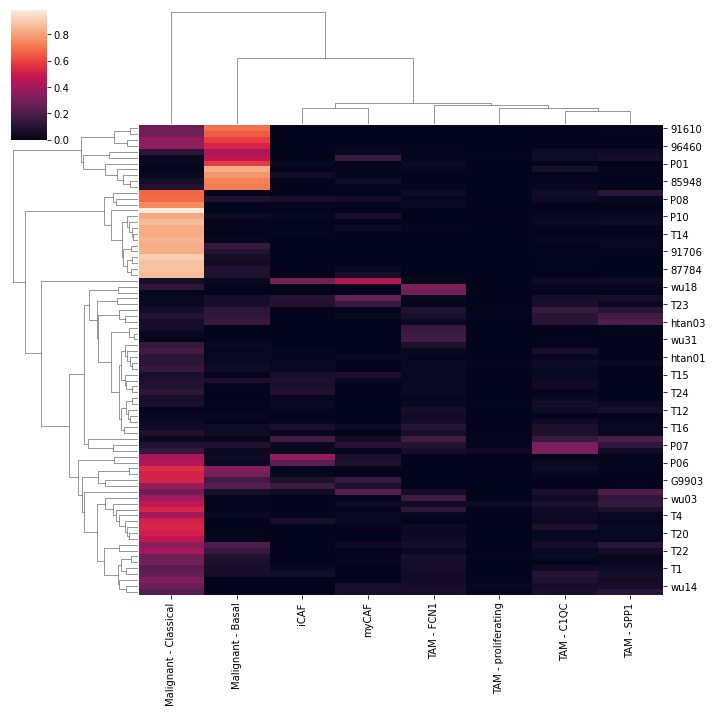

In [76]:
cols = [c for c in df.columns
         if 'TAM' in c or 'CAF' in c or 'Malignant' in c]

sns.clustermap(df[cols])

In [92]:
f

,iCAF,myCAF
100070,0.000000,0.001816
85948,0.004844,0.035227
87235,0.362918,0.068071
87784,0.004468,0.026363
90209_CMP,0.000000,0.060806
...,...,...
wu31,0.000000,0.000000
wu32,0.000000,0.000000
wu38,0.000000,0.017241
wu39,0.006343,0.013651


In [94]:
f = df[['iCAF', 'myCAF']]
f = f / np.sum(f.values, axis=1).reshape(-1, 1)

<AxesSubplot:xlabel='sample_id'>

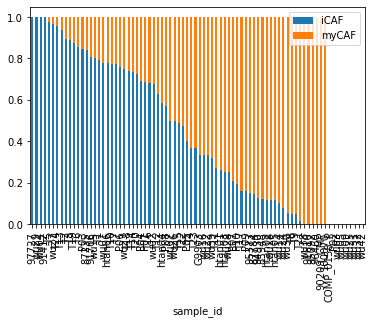

In [96]:
f = df[['iCAF', 'myCAF']]
f = f / np.sum(f.values, axis=1).reshape(-1, 1)
f['sample_id'] = f.index
f = f.sort_values('myCAF')

f.plot(x='sample_id', kind='bar', stacked=True)

In [84]:
f = a[a.obs['cell_type']=='Normal Epithelial']
f

View of AnnData object with n_obs × n_vars = 9744 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets score

In [82]:
f = a[a.obs['cell_type']=='Malignant']
f

View of AnnData object with n_obs × n_vars = 75659 × 3000
    obs: 'sample_id', 'dataset', 'tissue_type', 'doublet_score', 'is_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Bailey | ADEX score', 'Collison | Exocrine-like score', 'Moffit | Basal score', 'Bailey | Squamous-like score', 'Bailey | Pancreatic-Progenitor score', 'Bailey | Immunogenic score', 'Collison | Quasi-Mesenchymal score', 'Collison | Classical score', 'Moffit | Classical score', 'subTME | deserted score', 'subTME | reactive score', 'raghaven | scBasal score', 'raghaven | scClassical score', 'raghaven | IC score', 'raghaven | Pericyte-like score', 'raghaven | Fibroblast-like score', 'raghaven | Inflammatory score', 'raghaven | TAM-FCN1 score', 'raghaven | TAM-C1QC score', 'raghaven | TAM-SPP1 score', 'elyada | myCAF score', 'elyada | iCAF score', 'elyada | apCAF score', 'ben-porath | ES exp1 score', 'ben-porath | ES exp2 score', 'ben-porath | Nanog targets scor

In [83]:
set(f.obs['cell_type_specific'])

{'Malignant - Basal', 'Malignant - Classical'}

<AxesSubplot:xlabel='myCAF', ylabel='TAM - SPP1'>

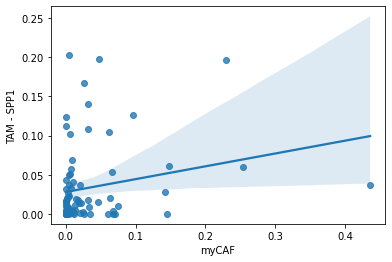

In [79]:
sns.regplot(data=df, x='myCAF', y='TAM - SPP1')
# plt.xlim(0., .1)

In [ ]:
cellp